# Introduction to Probabilistic Graphical Models
## Practical Session 2: Expectation-Maximization Algorithm for Gaussian Mixture Model
**Student: VU Thi Hai Yen (haiyen96.hp@gmail.com)**

In [1]:
import numpy as np
import matplotlib.pyplot as plt

### Log-sum-exp trick

In [2]:
def logsumexp(v):
    v = np.array(v)
    a = np.max(v)
    u = v-a
    return np.log(np.sum(np.exp(u)))+a

### Question 1 - Calculate $\gamma_k(x_n)$

In [3]:
def log_piGaussian(x,pi,mu,logdet_Sigma, inv_Sigma):
    """
    Calculate and return log(pi*N(x;mu, Sigma)).
    """
    import math
    d = len(x)
    output = np.log(pi) - d/2*np.log(2*math.pi) - 0.5*logdet_Sigma - 0.5* ((x-mu).T @ inv_Sigma @ (x-mu))
    return output

In [4]:
def gamma(X, list_pi, list_mu, list_Sigma):
    """
    Calculate the N*K gamma functions at each step, gamma_nk = gamma_k(x_n).
    Return the N x K matrix of gamma, and the log likelihood of the dataset of this step.
    """
    
    K = len(list_pi)
    N = len(X)
    list_logdet_Sigma = []
    list_inv_Sigma = []
    
    for Sigma in list_Sigma:
        logdet_Sigma = np.linalg.slogdet(Sigma)[1]
        inv_Sigma = np.linalg.inv(Sigma)
        
        list_logdet_Sigma.append(logdet_Sigma)
        list_inv_Sigma.append(inv_Sigma)
    
    list_gamma = []
    list_log_likelihood = []
    for n in range(N):
        l = []
        for i in range(K):
            l_i = log_piGaussian(X[n],list_pi[i],list_mu[i],list_logdet_Sigma[i],list_inv_Sigma[i])
            l.append(l_i)
        logsumexp_l = logsumexp(l)
        list_gamma_n = l - logsumexp_l
        
        list_gamma.append(np.exp(list_gamma_n))
        list_log_likelihood.append(logsumexp_l)
    
    log_likelihood = np.sum(list_log_likelihood)

    return np.asarray(list_gamma), log_likelihood

### Question 3.1 - Generation of dataset

In [5]:
def GMM_Simulation(v_pi,v_mu,v_Sigma,N=1000):
    """
    Simulation of a Gaussian Mixture Model with a given 
        v_pi: list of weights ,
        v_mu: list of mu ,
        v_Sigma: list of covariance matrices .
    Return the simulated data X, with the associated hidden data Z.
    """
    K = len(v_pi)
    
    list_Z = np.random.choice(K, size=N, p=v_pi)
    list_X = []
    for z_n in list_Z:
        x_n = np.random.multivariate_normal(v_mu[z_n], v_Sigma[z_n])
        list_X.append(x_n)
    return np.asarray(list_X),np.asarray(list_Z)

In [6]:
v_pi = [0.3,0.2,0.5]
v_mu = [[0.,0.],[1.,2.],[2.,0.]]
v_Sigma = [[[1.00, -0.25],[-0.25, 0.50]],[[0.50, 0.25],[0.25, 0.50]],[[0.50, -0.25],[-0.25, 1.]]]

X_samples, Z_samples = GMM_Simulation(v_pi,v_mu,v_Sigma,N=1000)

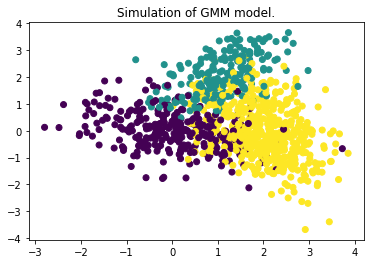

In [7]:
plt.scatter(X_samples[:,0], X_samples[:,1], c=Z_samples)
plt.title("Simulation of GMM model.")
plt.show()

### Question 3.2 - Perform EM for GMM

In [8]:
############################################
#    Visualizing the parameters of GMM.    #
############################################

from matplotlib.patches import Ellipse

def plot_cov_ellipse(cov, pos, nstd=2, ax=None, **kwargs):
    """
    from https://stackoverflow.com/questions/12301071/multidimensional-confidence-intervals/12321306#12321306
    Plots an `nstd` sigma error ellipse based on the specified covariance
    matrix (`cov`). Additional keyword arguments are passed on to the 
    ellipse patch artist.

    Parameters
    ----------
        cov : The 2x2 covariance matrix to base the ellipse on
        pos : The location of the center of the ellipse. Expects a 2-element
            sequence of [x0, y0].
        nstd : The radius of the ellipse in numbers of standard deviations.
            Defaults to 2 standard deviations.
        ax : The axis that the ellipse will be plotted on. Defaults to the 
            current axis.
        Additional keyword arguments are pass on to the ellipse patch.

    Returns
    -------
        A matplotlib ellipse artist
    """
    def eigsorted(cov):
        vals, vecs = np.linalg.eigh(cov)
        order = vals.argsort()[::-1]
        return vals[order], vecs[:,order]

    if ax is None:
        ax = plt.gca()

    vals, vecs = eigsorted(cov)
    theta = np.degrees(np.arctan2(*vecs[:,0][::-1]))

    # Width and height are "full" widths, not radius
    width, height = 2 * nstd * np.sqrt(vals)
    ellip = Ellipse(xy=pos, width=width, height=height, angle=theta, **kwargs)

    ax.add_artist(ellip)
    return ellip

def visualise_EM(X,Z, mu_list, Sigma_list):
    """
    Visualise a step of EM.
    """
    plt.scatter(X[:,0], X[:,1], c=Z)
    for k in range(len(mu_list)):
        plot_cov_ellipse(Sigma_list[k], mu_list[k], nstd=3, alpha=0.2, color='green')
        plt.scatter(mu_list[k][0], mu_list[k][1], s=20, c='red')
    plt.show()

In [9]:
def EM_GMM(X,K,n_iteration,print_out=True, plot_out=True, inits=None):
    """
    Perform an EM algorithm for GMM model.
    """
    N = X.shape[0]
    d = X.shape[1]

    # Initialisation of parameters
    if inits == None:
        init_v_pi = np.random.random(K)
        init_v_pi = init_v_pi/np.sum(init_v_pi) 
        init_v_mu = np.random.rand(K,d)
        init_v_Sigma = np.random.rand(K,d,d)
    else:
        init_v_pi = inits[0]
        init_v_mu = inits[1]
        init_v_Sigma = inits[2]

    print("EM algo for GMM starts! Initial values:")
    print("weights:")
    print(init_v_pi)
    print("mu:")
    print(init_v_mu)
    print("Sigma:")
    print(init_v_Sigma)

    list_pi_temp = init_v_pi
    list_mu_temp = init_v_mu
    list_Sigma_temp = init_v_Sigma

    log_likelihoods = []

    # Each M-step of EM
    for t in range(n_iteration):
        if print_out :
            print("Step {}".format(t))
            print("weights:")
            print(list_pi_temp)
            print("mu:")
            print(list_mu_temp)
            print("Sigma:")
            print(list_Sigma_temp)
        if plot_out:
            if not print_out :
                print("Step {}".format(t))
            visualise_EM(X_samples,Z_samples, list_mu_temp, list_Sigma_temp)

        # Calculate the gammas
        matrix_gamma_temp, loglikelihood_temp = gamma(X,list_pi_temp,list_mu_temp,list_Sigma_temp) #dim NxK

        list_pi_new = []
        list_mu_new = []
        list_Sigma_new = []

        # Calculate pi(t+1), mu(t+1), Sigma(t+1)
        for k in range(K):
            pi_new = np.mean(matrix_gamma_temp[:,k])
            mu_new = np.sum(matrix_gamma_temp[:,k].reshape(-1,1) * X, axis = 0) / np.sum(matrix_gamma_temp[:,k])
            Sigma_new = np.zeros((d,d))
            for n in range(N):
                Sigma_new += matrix_gamma_temp[n,k] * ((X[n] - mu_new).reshape(-1,1) @ (X[n] - mu_new).reshape(1,-1)) 
            Sigma_new = Sigma_new/np.sum(matrix_gamma_temp[:,k])

            list_pi_new.append(pi_new)
            list_mu_new.append(mu_new)
            list_Sigma_new.append(Sigma_new)

        list_pi_temp = list_pi_new
        list_mu_temp = list_mu_new
        list_Sigma_temp = list_Sigma_new

        log_likelihoods.append(loglikelihood_temp)

    return list_pi_temp, list_mu_temp, list_Sigma_temp, log_likelihoods

#### Let's try to run our algorithm

EM algo for GMM starts! Initial values:
weights:
[0.44535011 0.12181532 0.43283458]
mu:
[[0.2202551  0.69937315]
 [0.44180117 0.19658469]
 [0.25111114 0.97176562]]
Sigma:
[[[0.44331255 0.66768353]
  [0.95173246 0.28599645]]

 [[0.180456   0.91068456]
  [0.62191662 0.40899701]]

 [[0.05570858 0.89478568]
  [0.24925575 0.52756116]]]
Step 0


D:\Anaconda3\lib\site-packages\ipykernel_launcher.py:41: RuntimeWarning: invalid value encountered in sqrt


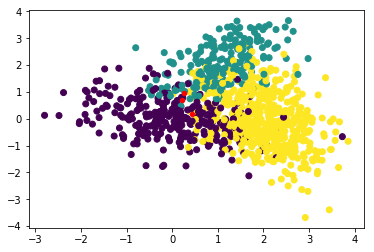

Step 1


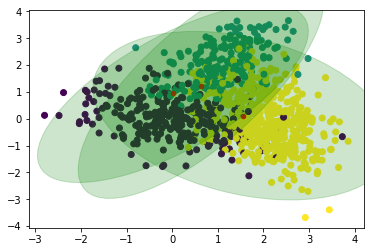

Step 2


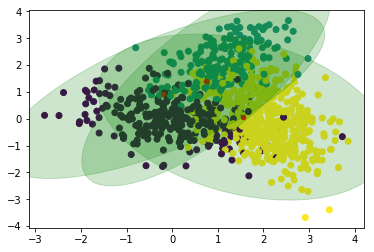

Step 3


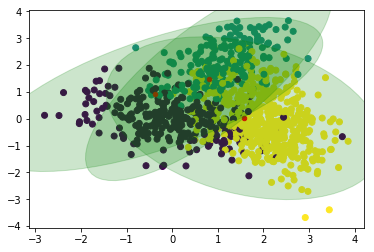

Step 4


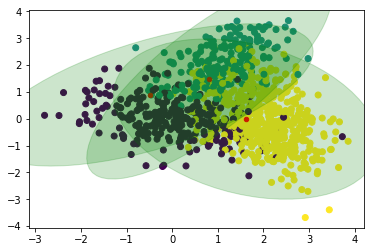

Step 5


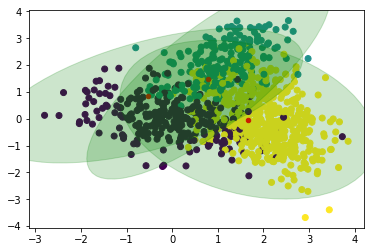

Step 6


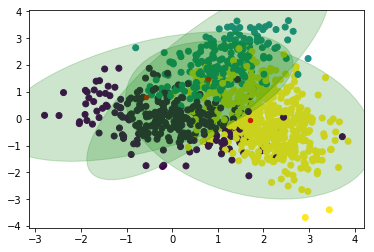

Step 7


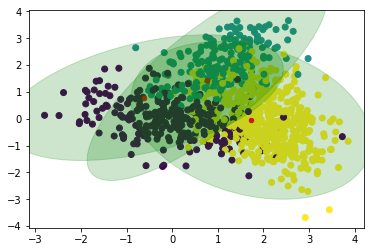

Step 8


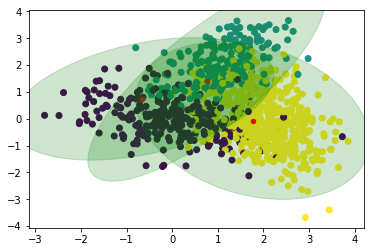

Step 9


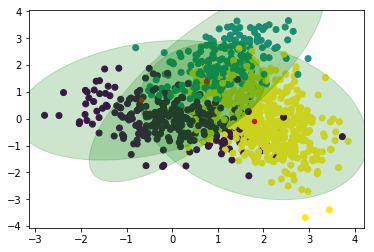

Step 10


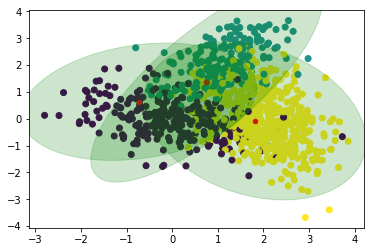

Step 11


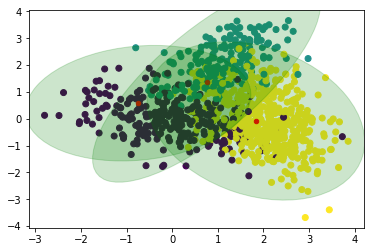

Step 12


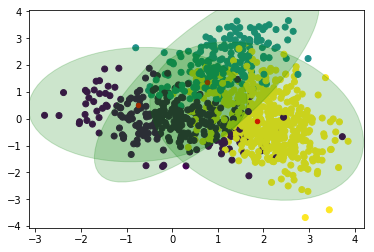

Step 13


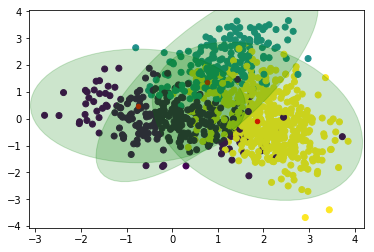

Step 14


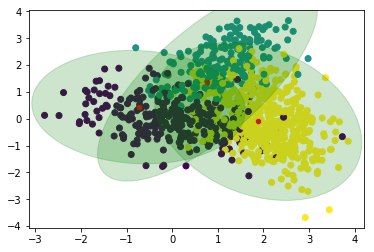

Step 15


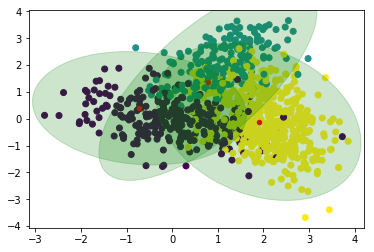

Step 16


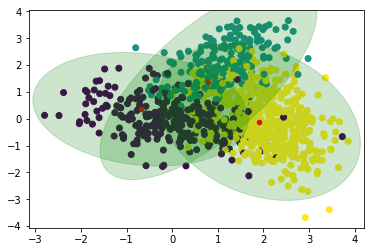

Step 17


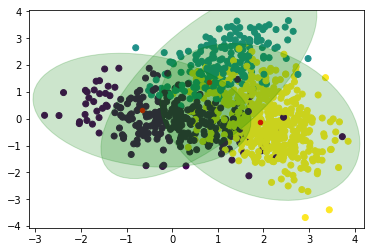

Step 18


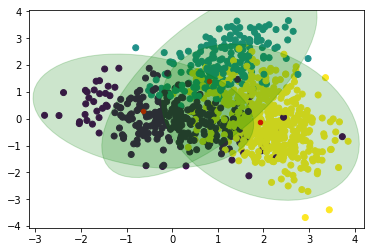

Step 19


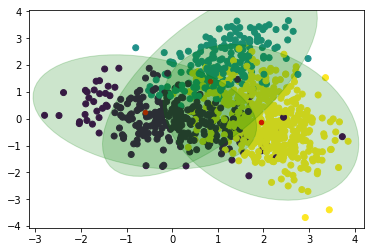

In [25]:
list_pi_final, list_mu_final, list_Sigma_final, log_likelihoods = EM_GMM(X_samples,K=3,n_iteration=20,print_out=False)

We see that the algorithm tends to modelize well the data, we continue training for a little while.

EM algo for GMM starts! Initial values:
weights:
[0.30848760880306775, 0.13507697715852943, 0.5564354140384028]
mu:
[array([0.83966307, 1.41894199]), array([-0.56520754,  0.22993275]), array([ 1.95875247, -0.13991498])]
Sigma:
[array([[0.61454429, 0.60043575],
       [0.60043575, 1.37570399]]), array([[ 0.68670164, -0.16656393],
       [-0.16656393,  0.50370178]]), array([[ 0.50162064, -0.18845423],
       [-0.18845423,  0.92773218]])]
Step 0


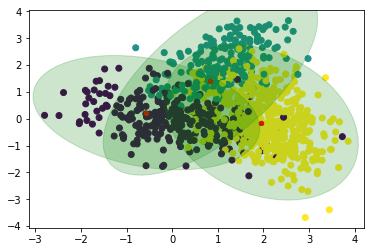

Step 1


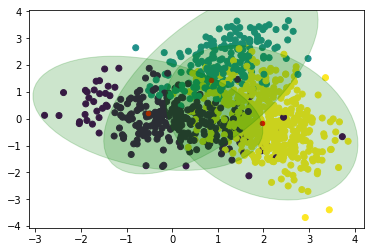

Step 2


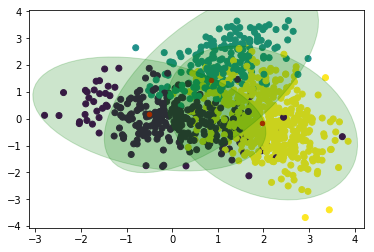

Step 3


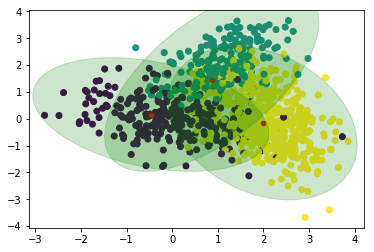

Step 4


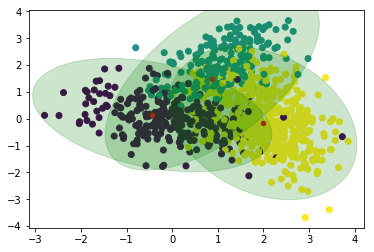

Step 5


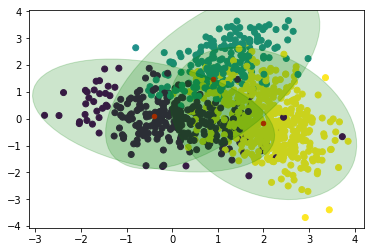

Step 6


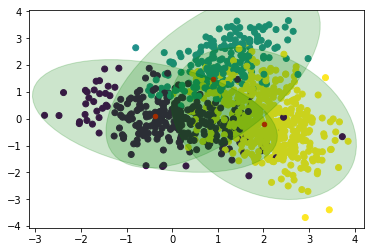

Step 7


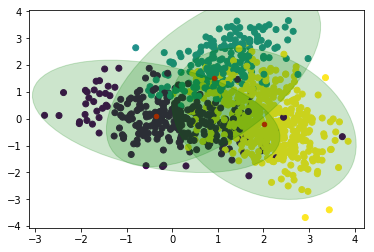

Step 8


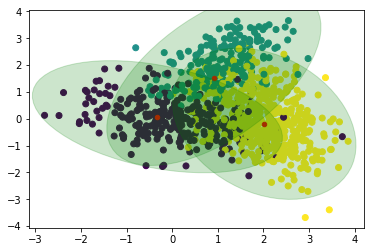

Step 9


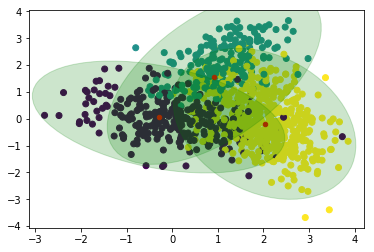

Step 10


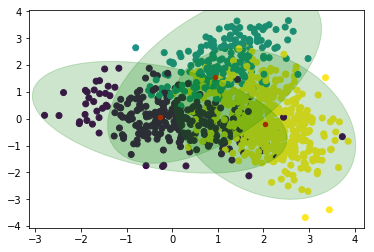

Step 11


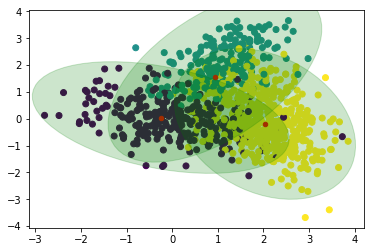

Step 12


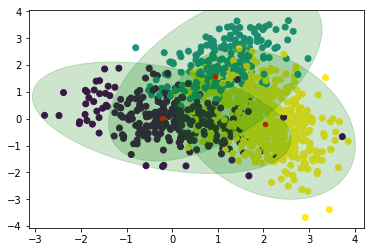

Step 13


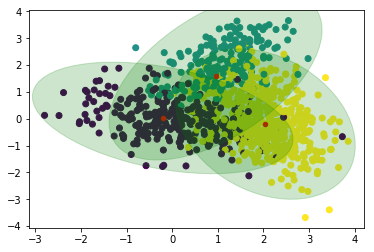

Step 14


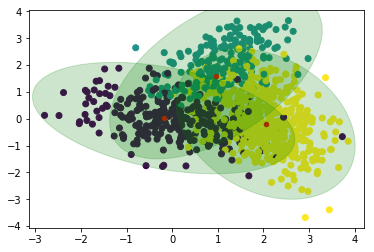

Step 15


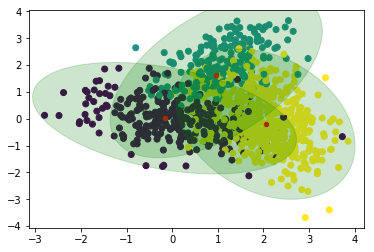

Step 16


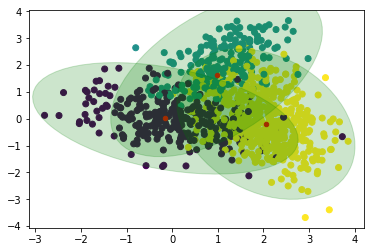

Step 17


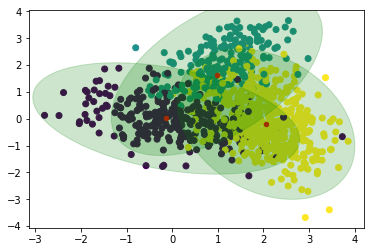

Step 18


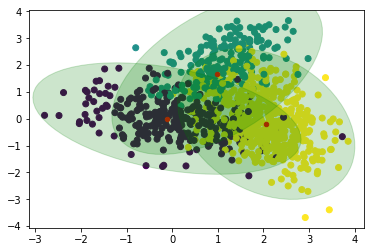

Step 19


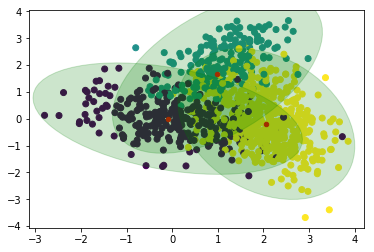

Step 20


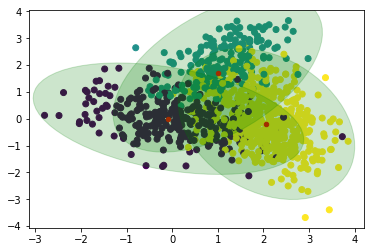

Step 21


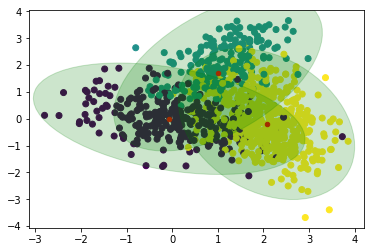

Step 22


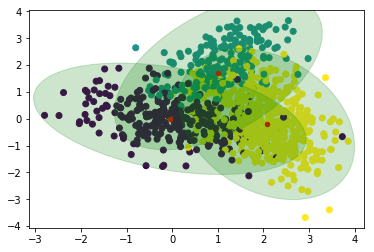

Step 23


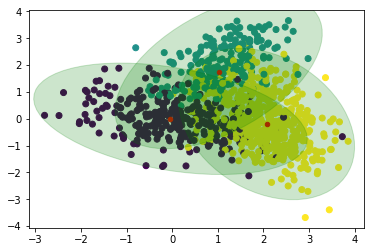

Step 24


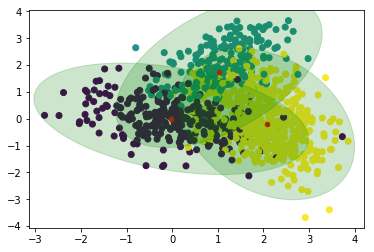

Step 25


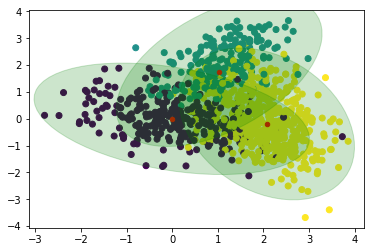

Step 26


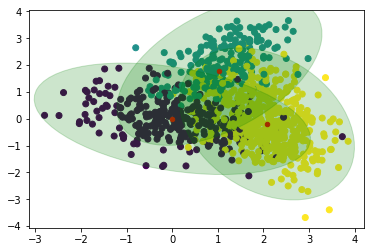

Step 27


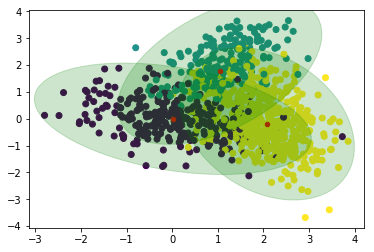

Step 28


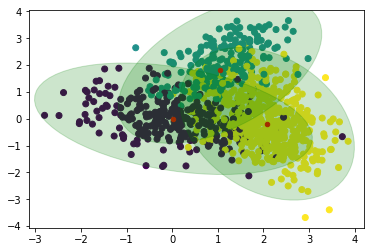

Step 29


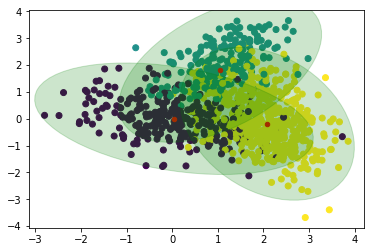

Step 30


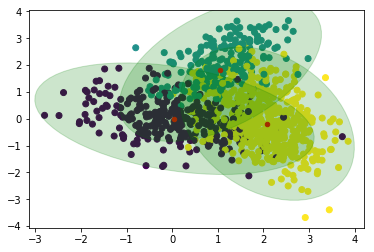

Step 31


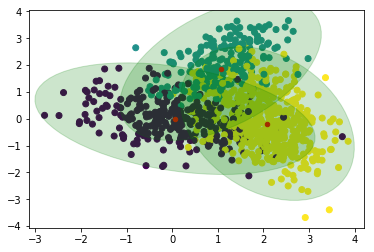

Step 32


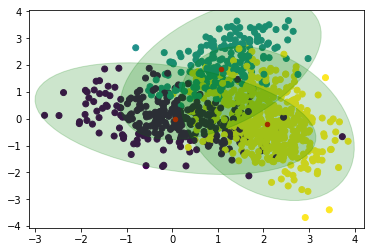

Step 33


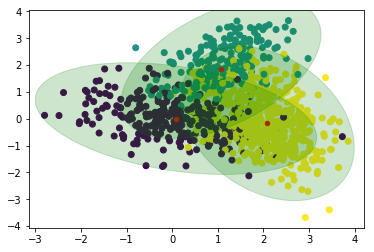

Step 34


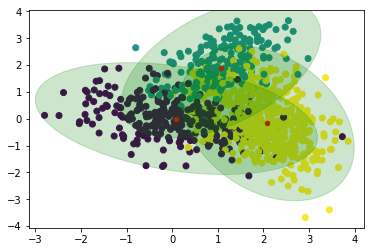

Step 35


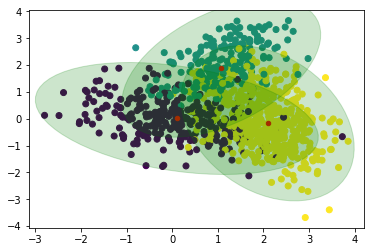

Step 36


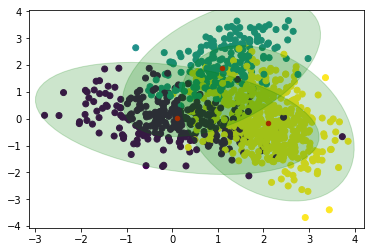

Step 37


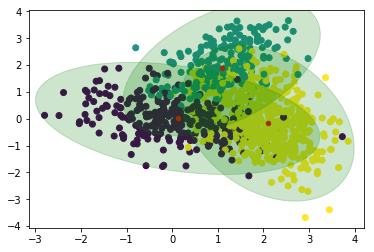

Step 38


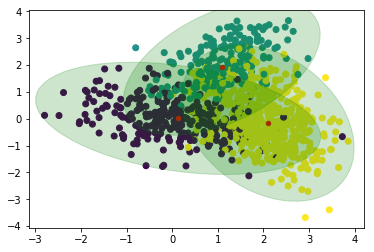

Step 39


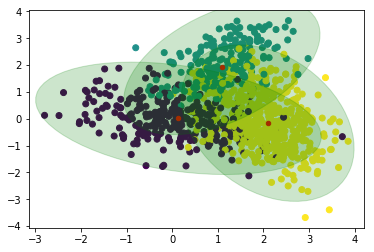

Step 40


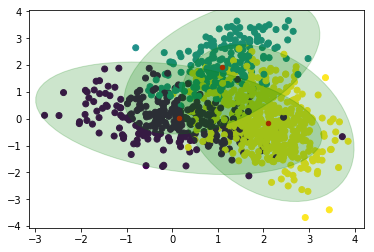

Step 41


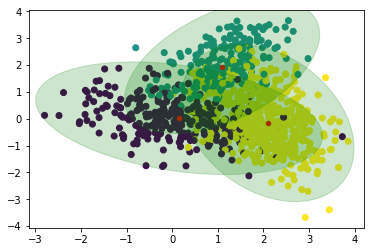

Step 42


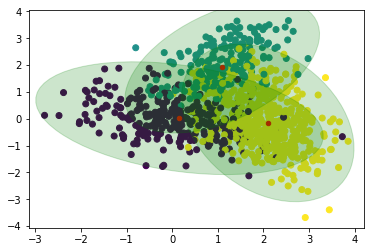

Step 43


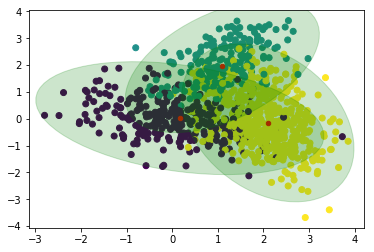

Step 44


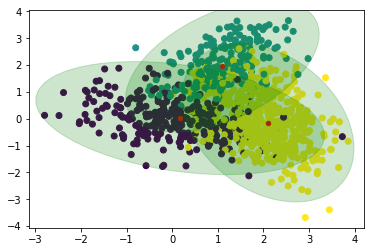

Step 45


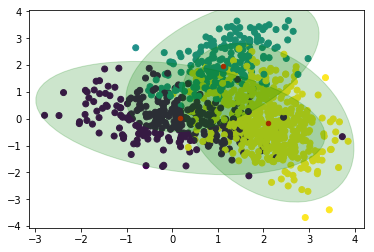

Step 46


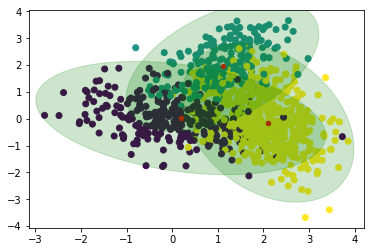

Step 47


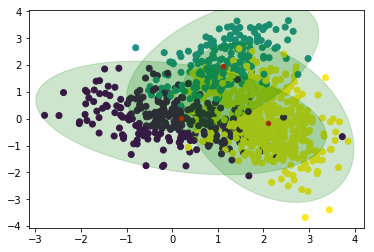

Step 48


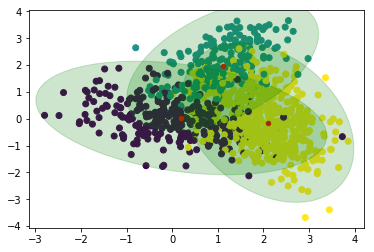

Step 49


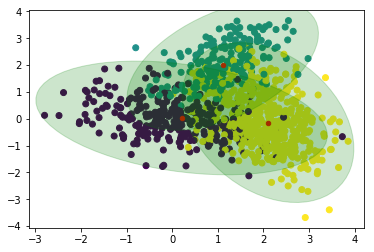

Step 50


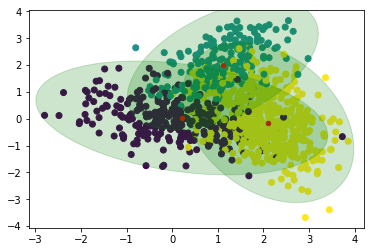

Step 51


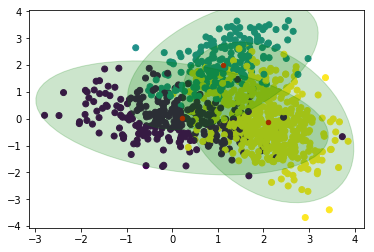

Step 52


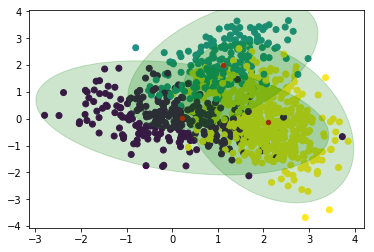

Step 53


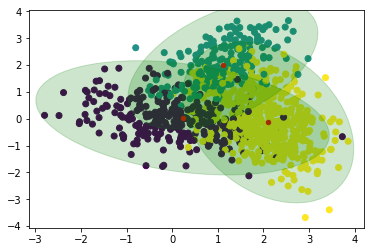

Step 54


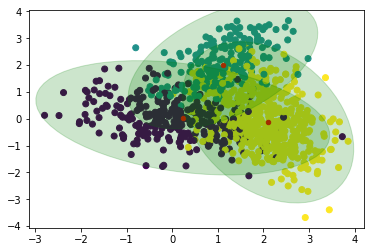

Step 55


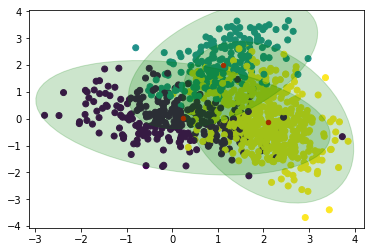

Step 56


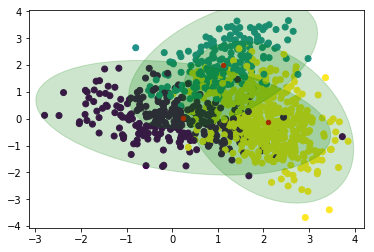

Step 57


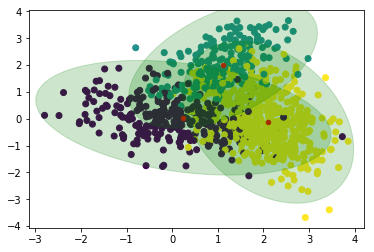

Step 58


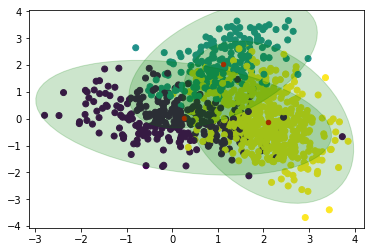

Step 59


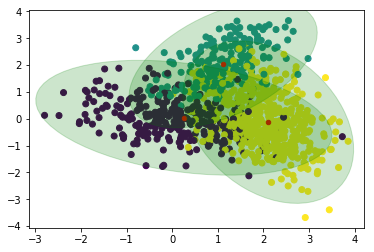

Step 60


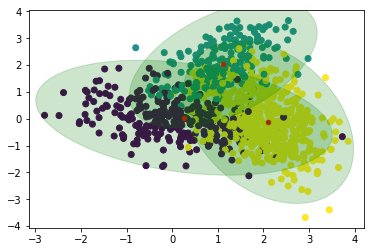

Step 61


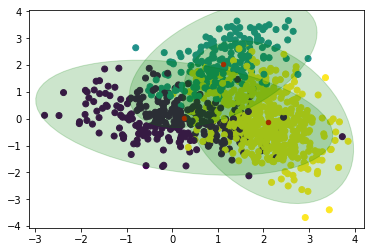

Step 62


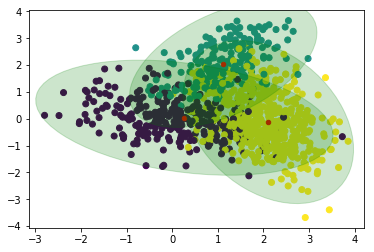

Step 63


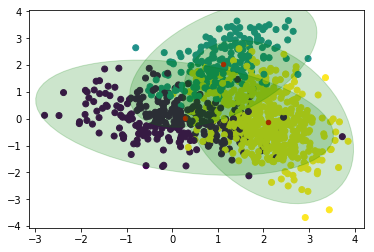

Step 64


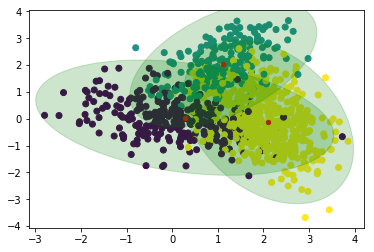

Step 65


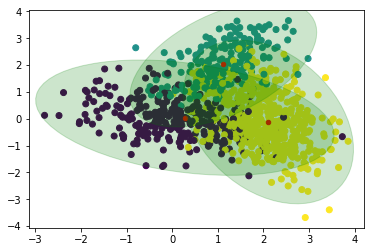

Step 66


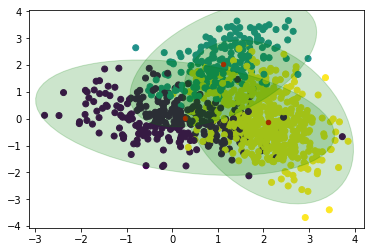

Step 67


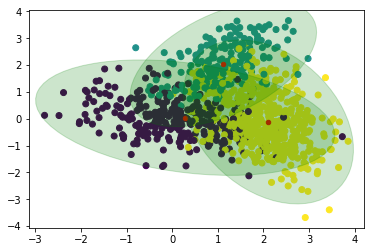

Step 68


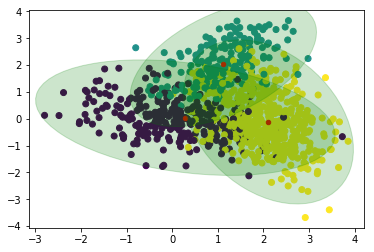

Step 69


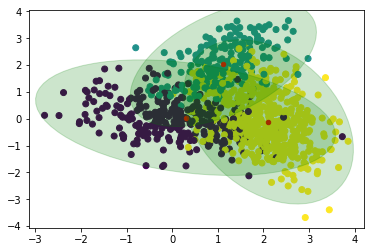

Step 70


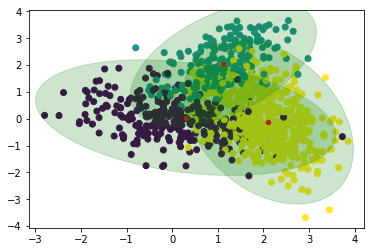

Step 71


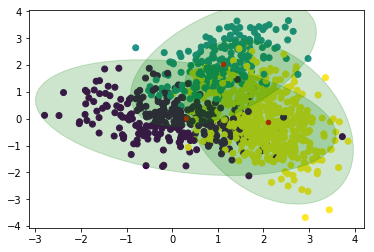

Step 72


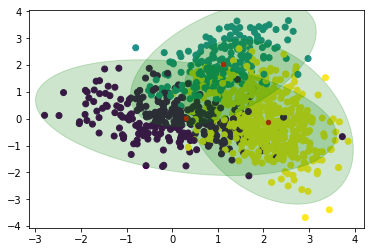

Step 73


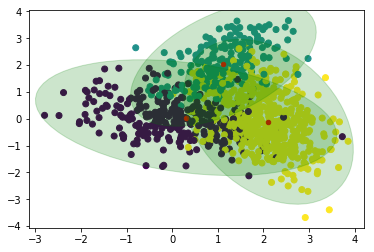

Step 74


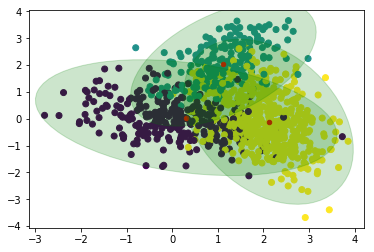

Step 75


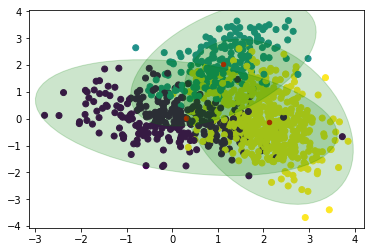

Step 76


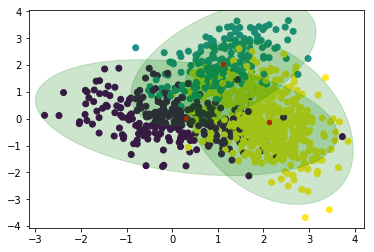

Step 77


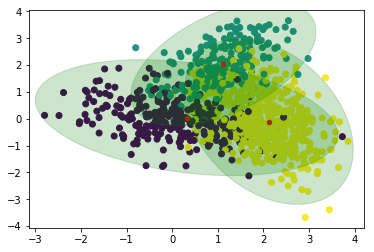

Step 78


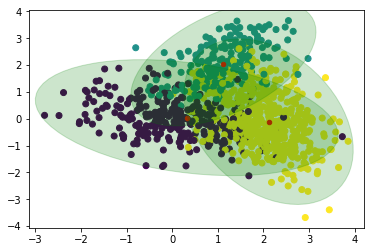

Step 79


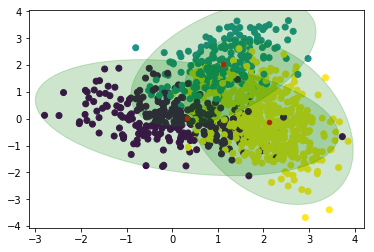

Step 80


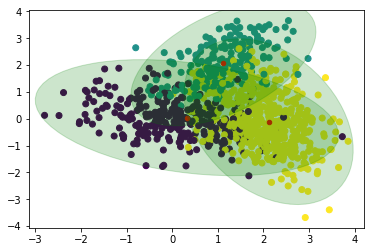

Step 81


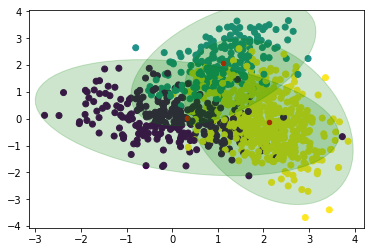

Step 82


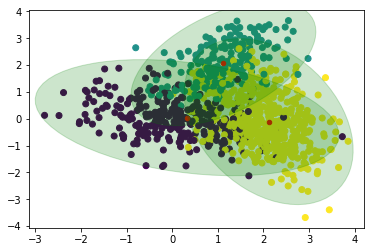

Step 83


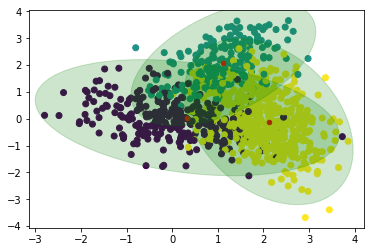

Step 84


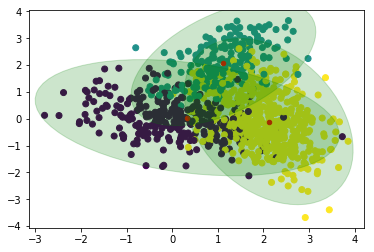

Step 85


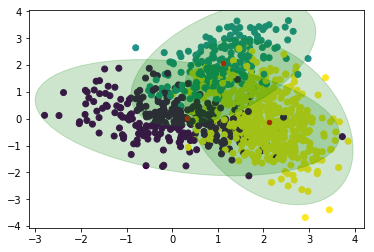

Step 86


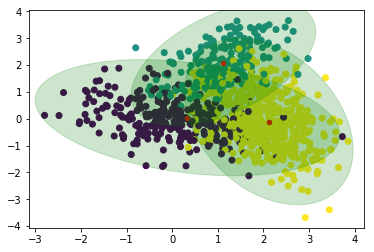

Step 87


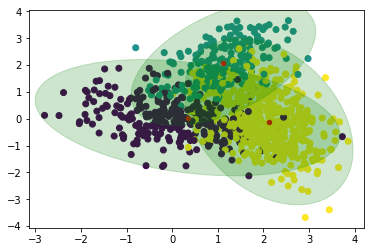

Step 88


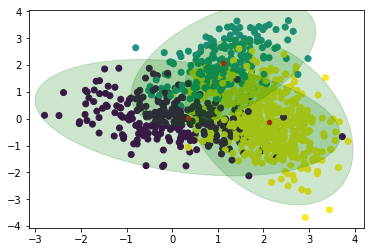

Step 89


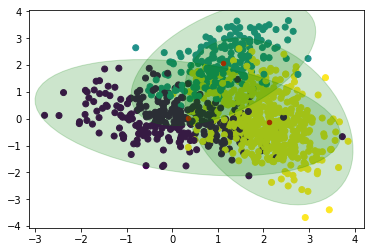

Step 90


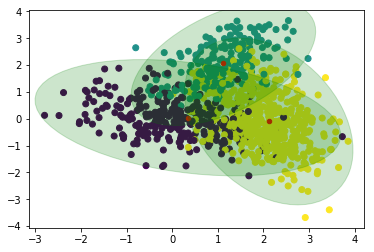

Step 91


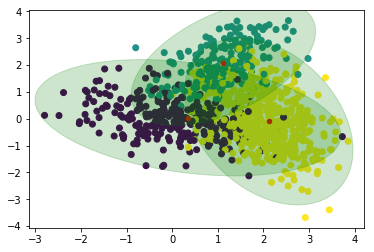

Step 92


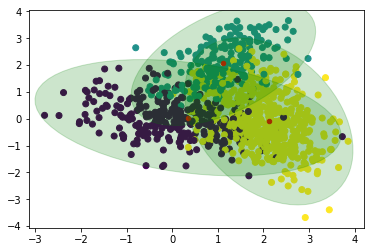

Step 93


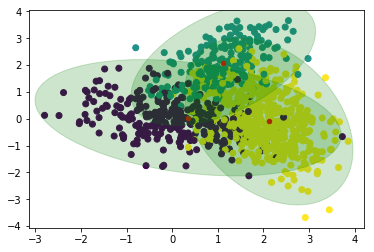

Step 94


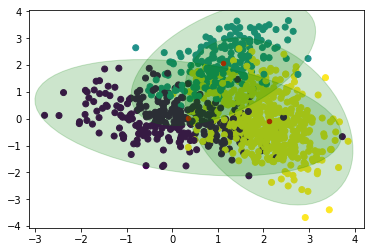

Step 95


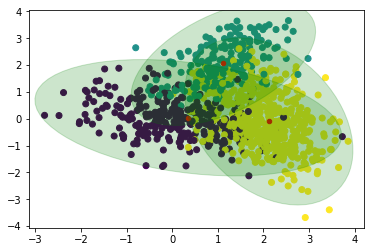

Step 96


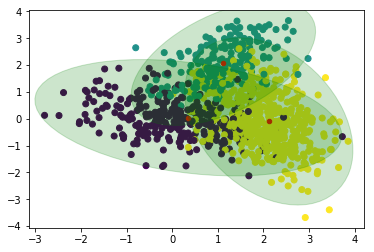

Step 97


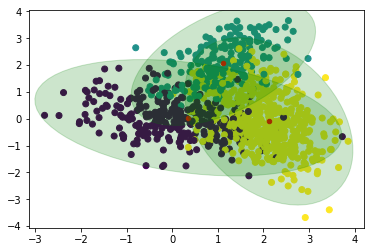

Step 98


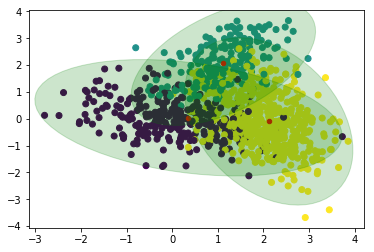

Step 99


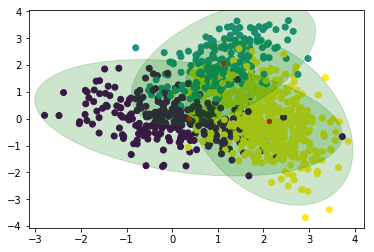

In [26]:
list_pi_final, list_mu_final, list_Sigma_final, log_likelihoods_cont = EM_GMM(X_samples,K=3,n_iteration=100,
                                                                              print_out=False,
                                                                              inits=(list_pi_final, 
                                                                                     list_mu_final, 
                                                                                     list_Sigma_final))
log_likelihoods.extend(log_likelihoods_cont)

We see that the algorithm succeed to modelize the GMM correctly !

To check that the model is indeed correct, we compare the learned parameters with the true parameters:

In [27]:
print("---------------------")
print("Learned weights:")
print(list_pi_final)
print("True weights: (permutation expected)")
print(v_pi)
print("---------------------")
print("Learned mu:")
print(list_mu_final)
print("True mu:  (permutation expected)")
print(v_mu)
print("---------------------")
print("Learned Sigma:")
print(list_Sigma_final)
print("True Sigma:  (permutation expected)")
print(v_Sigma)

---------------------
Learned weights:
[0.20218550628871987, 0.36715555366106467, 0.43065894005021543]
True weights: (permutation expected)
[0.3, 0.2, 0.5]
---------------------
Learned mu:
[array([1.12290868, 2.068763  ]), array([0.36092465, 0.03864993]), array([ 2.12011625, -0.0964416 ])]
True mu:  (permutation expected)
[[0.0, 0.0], [1.0, 2.0], [2.0, 0.0]]
---------------------
Learned Sigma:
[array([[0.45420333, 0.26858852],
       [0.26858852, 0.59430814]]), array([[ 1.26371244, -0.24688576],
       [-0.24688576,  0.52273699]]), array([[ 0.3776479 , -0.22071155],
       [-0.22071155,  1.08169459]])]
True Sigma:  (permutation expected)
[[[1.0, -0.25], [-0.25, 0.5]], [[0.5, 0.25], [0.25, 0.5]], [[0.5, -0.25], [-0.25, 1.0]]]


We obtain indeed the approximated values of the true model !

#### Log-likelihood Plot:

In [28]:
#Remove step 0 as Sigma(0) is not necessary positively defined
log_likelihoods = log_likelihoods[1:]

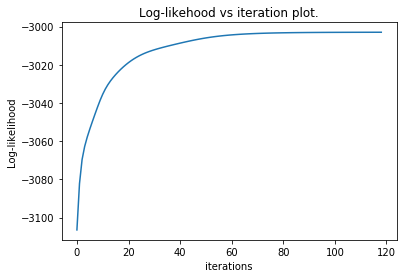

In [29]:
plt.plot(log_likelihoods)
plt.title("Log-likehood vs iteration plot.")
plt.xlabel('iterations')
plt.ylabel('Log-likelihood') 
plt.show()

In [30]:
print(log_likelihoods)

[-3106.4608332558428, -3082.222146800526, -3069.6342014812726, -3062.790110104953, -3057.87340548011, -3053.6536492389396, -3049.7173082293107, -3045.887291401462, -3042.1412259182744, -3038.600934035667, -3035.4390837551823, -3032.738980166555, -3030.457459805929, -3028.493869017935, -3026.755231762051, -3025.177847946896, -3023.724623766309, -3022.3763743326726, -3021.123983110341, -3019.9630067300222, -3018.8906210372998, -3017.904253661712, -3017.0011026710213, -3016.1778806501175, -3015.4304797061814, -3014.7536382363105, -3014.1408565610072, -3013.5846772131454, -3013.0772113061976, -3012.610689693094, -3012.1778803832008, -3011.7723287277186, -3011.388452996207, -3011.0215503257336, -3010.667759334374, -3010.32400805074, -3009.9879601944467, -3009.657962348445, -3009.332988985038, -3009.012580561734, -3008.696770833427, -3008.3860020347092, -3008.0810296471614, -3007.7828212029935, -3007.4924553582964, -3007.211027987588, -3006.939571326092, -3006.6789905027554, -3006.4300196085

The graph is well increasing !

#### Sensityvity to initial values

We start the algorithm with a given initial values:

EM algo for GMM starts! Initial values:
weights:
[0.37510264, 0.03801979, 0.58687757]
mu:
[[0.57893792, 0.38168862], [0.78415488, 0.06592463], [0.59199756, 0.30968324]]
Sigma:
[[[0.40593776, 0.92796719], [0.91882625, 0.57848892]], [[0.84921114, 0.8018145], [0.30160589, 0.71828568]], [[0.43224891, 0.63132965], [0.50335857, 0.25369865]]]
Step 0


D:\Anaconda3\lib\site-packages\ipykernel_launcher.py:41: RuntimeWarning: invalid value encountered in sqrt


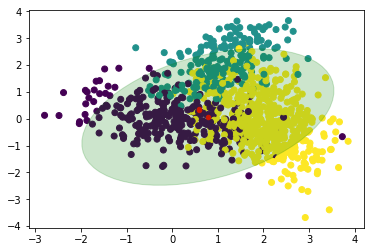

Step 1


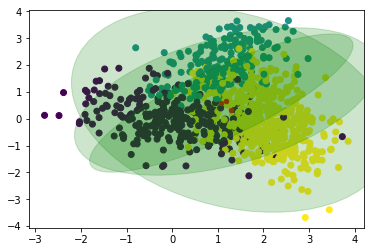

Step 2


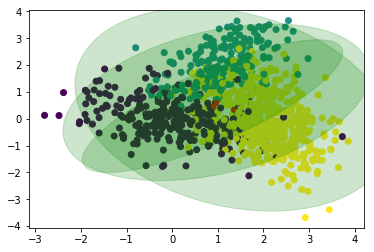

Step 3


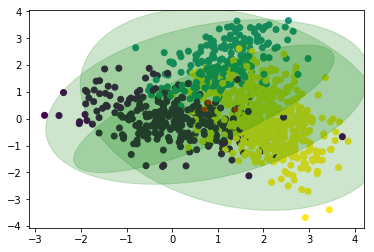

Step 4


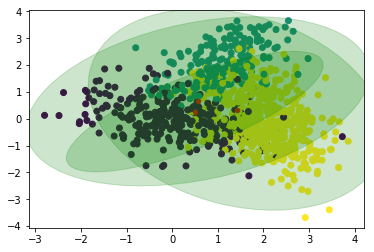

Step 5


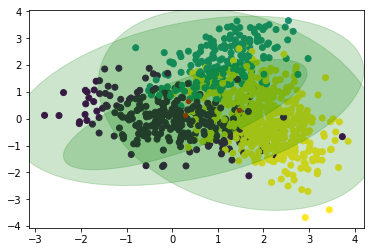

Step 6


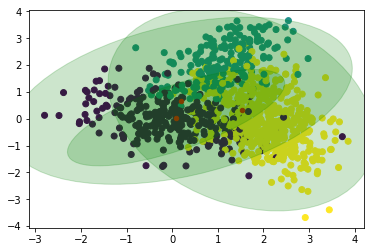

Step 7


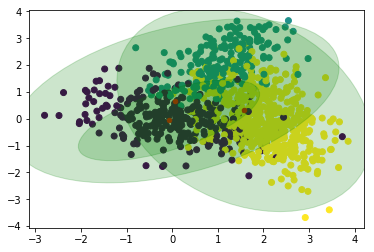

Step 8


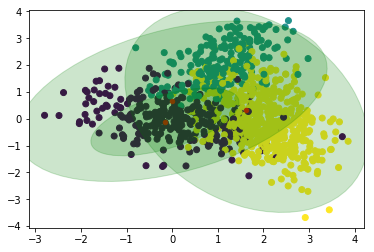

Step 9


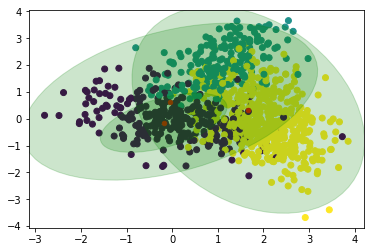

Step 10


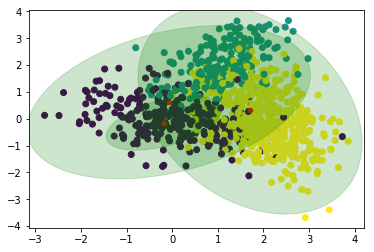

Step 11


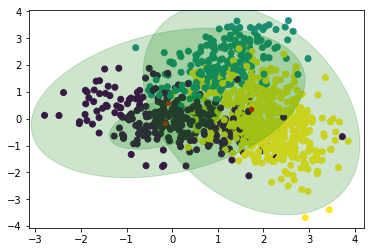

Step 12


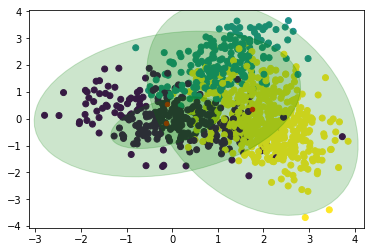

Step 13


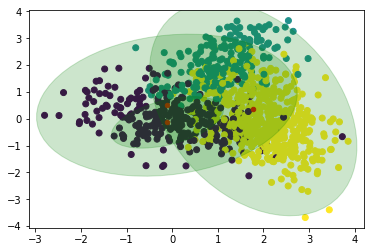

Step 14


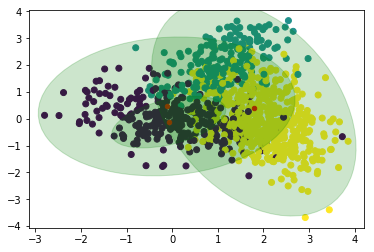

Step 15


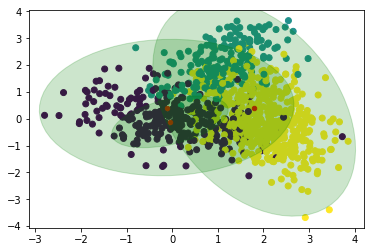

Step 16


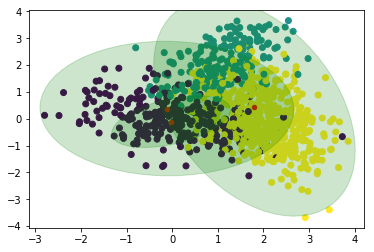

Step 17


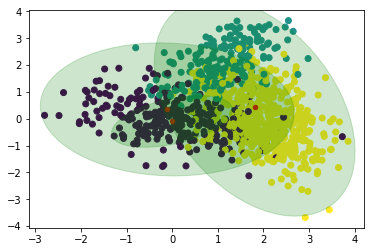

Step 18


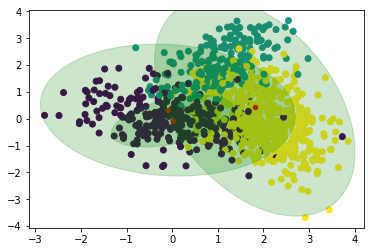

Step 19


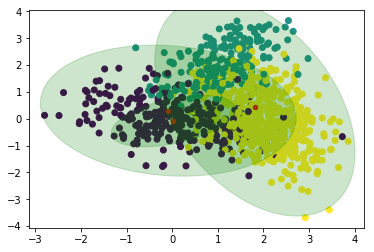

Step 20


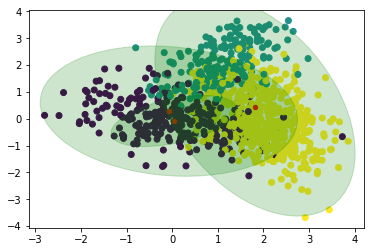

Step 21


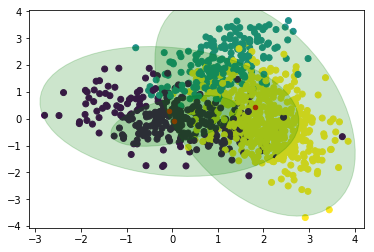

Step 22


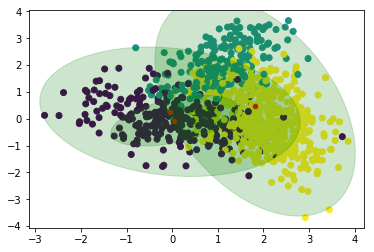

Step 23


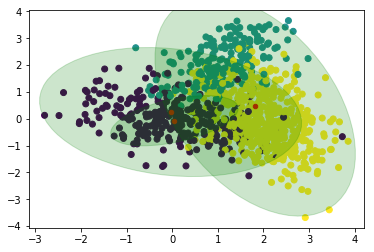

Step 24


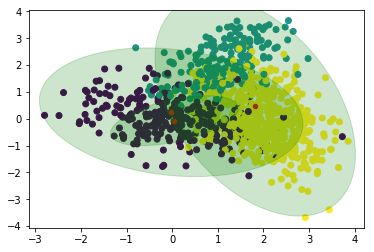

Step 25


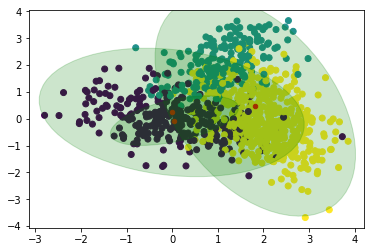

Step 26


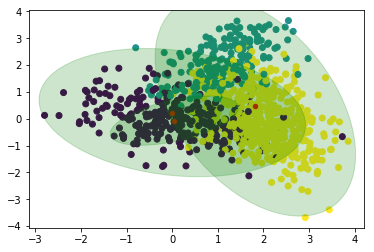

Step 27


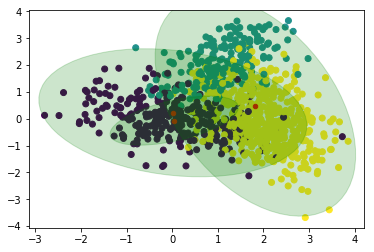

Step 28


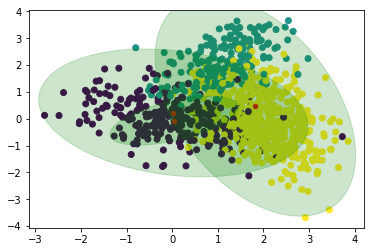

Step 29


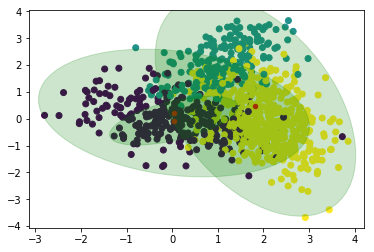

Step 30


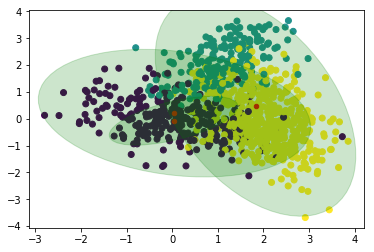

Step 31


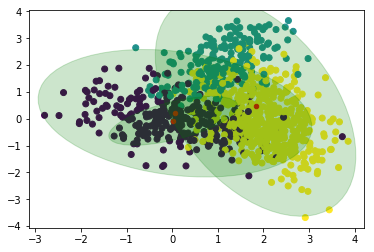

Step 32


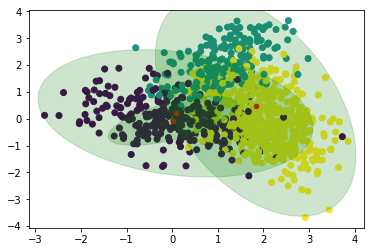

Step 33


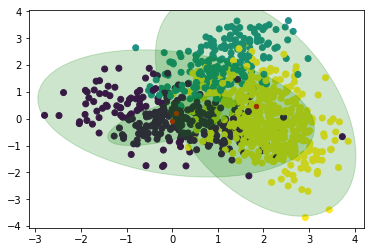

Step 34


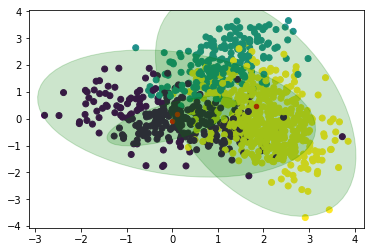

Step 35


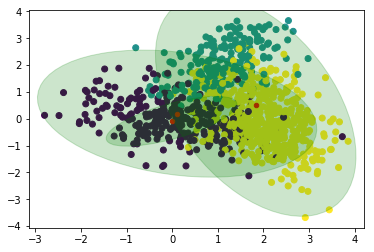

Step 36


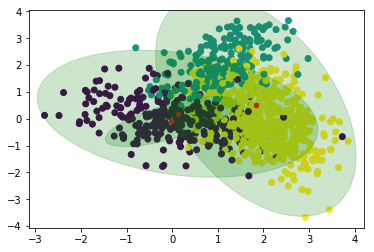

Step 37


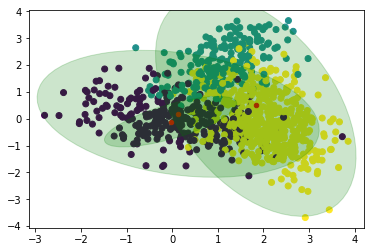

Step 38


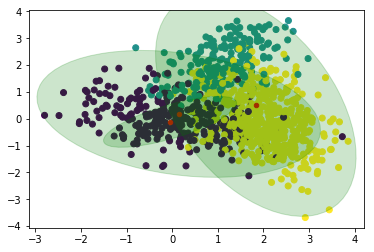

Step 39


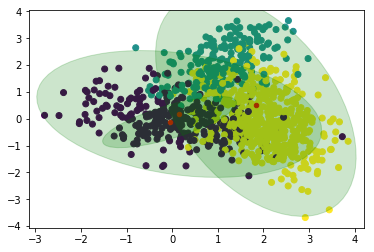

Step 40


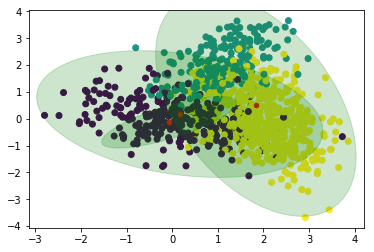

Step 41


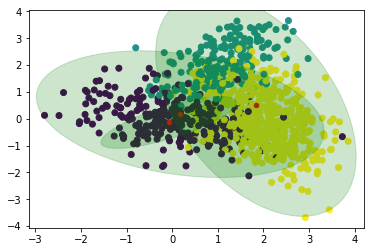

Step 42


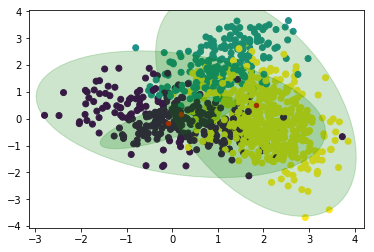

Step 43


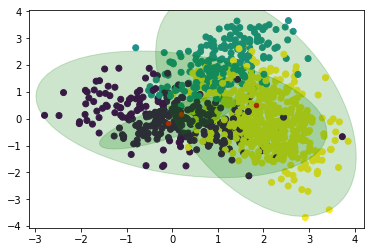

Step 44


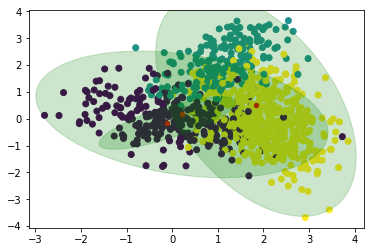

Step 45


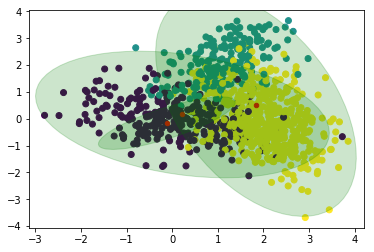

Step 46


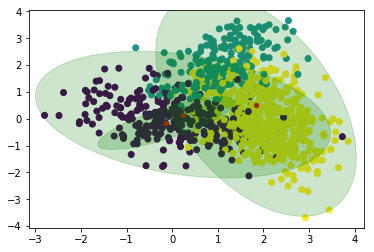

Step 47


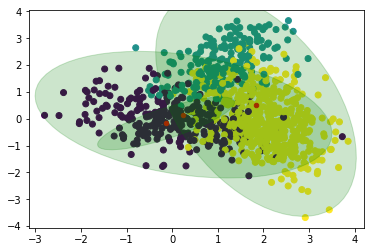

Step 48


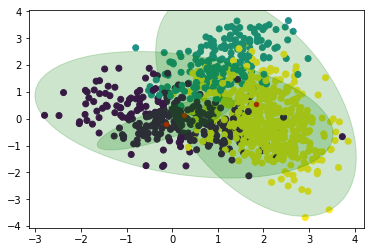

Step 49


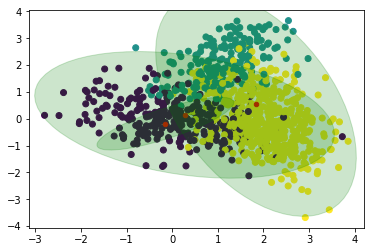

Step 50


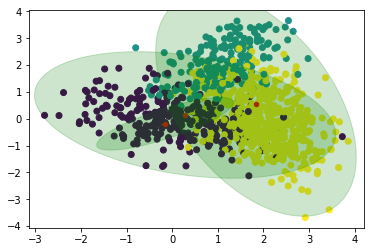

Step 51


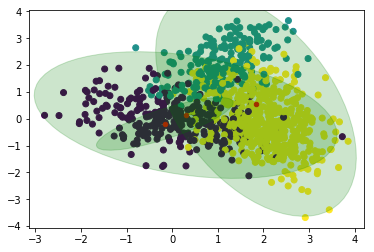

Step 52


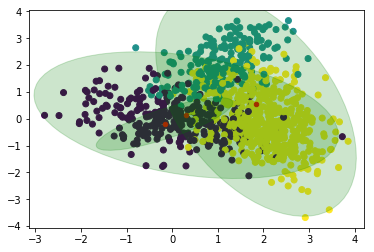

Step 53


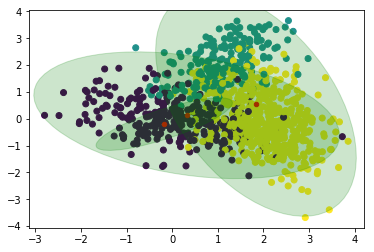

Step 54


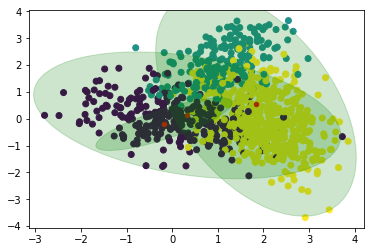

Step 55


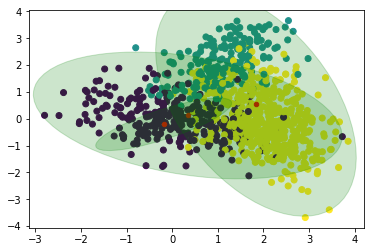

Step 56


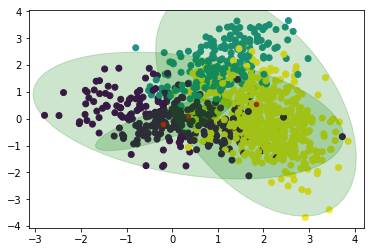

Step 57


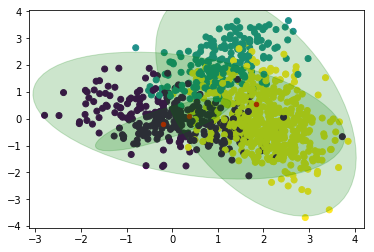

Step 58


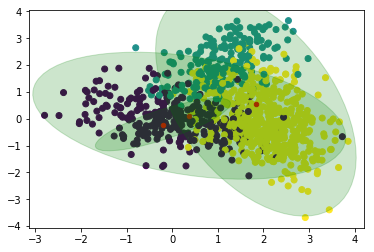

Step 59


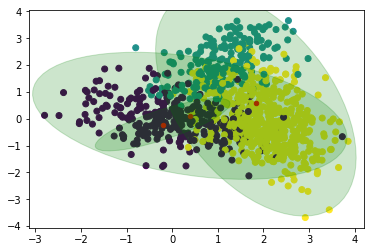

Step 60


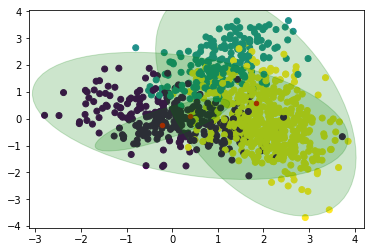

Step 61


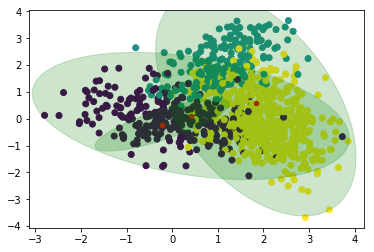

Step 62


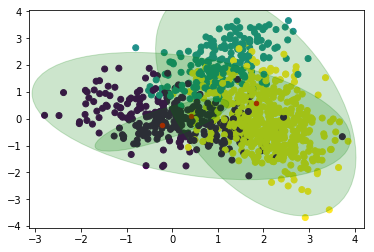

Step 63


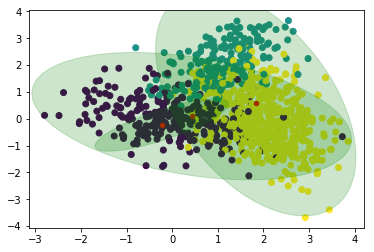

Step 64


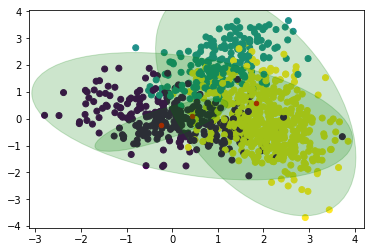

Step 65


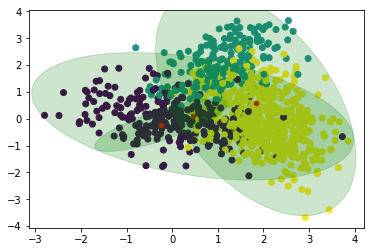

Step 66


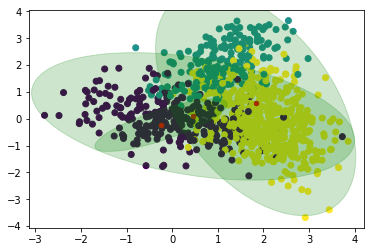

Step 67


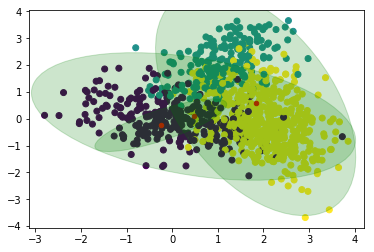

Step 68


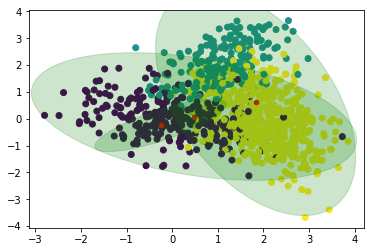

Step 69


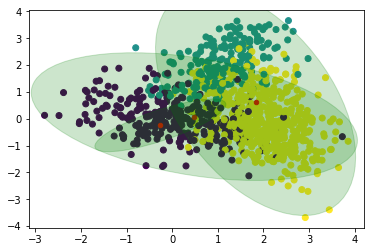

Step 70


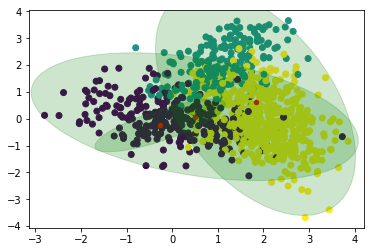

Step 71


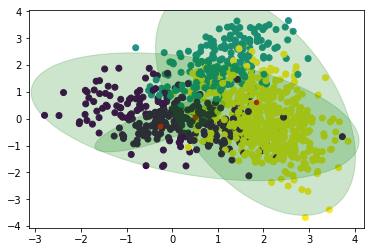

Step 72


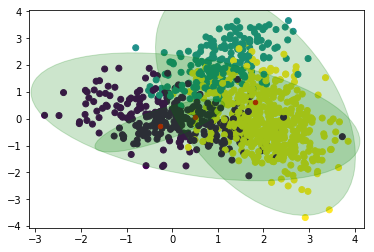

Step 73


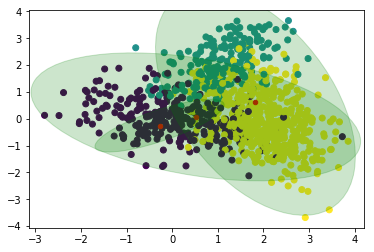

Step 74


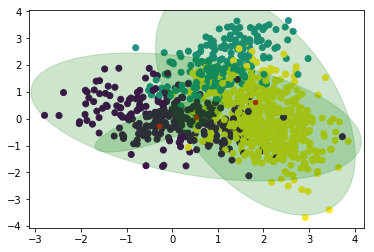

Step 75


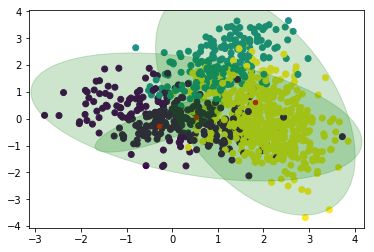

Step 76


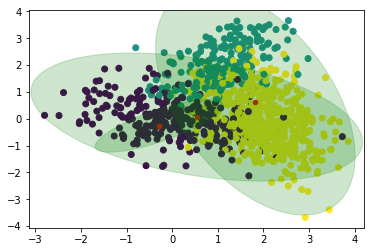

Step 77


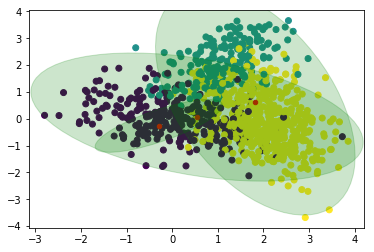

Step 78


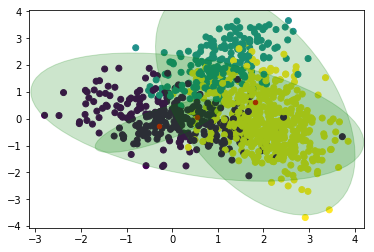

Step 79


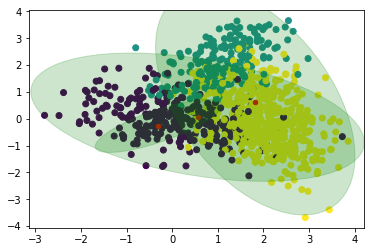

Step 80


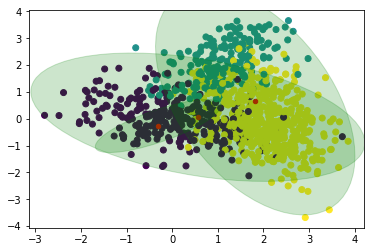

Step 81


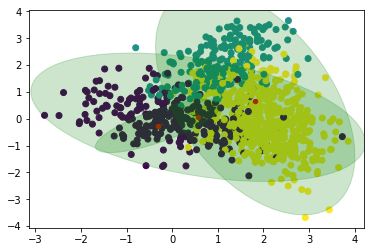

Step 82


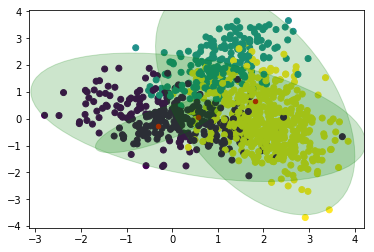

Step 83


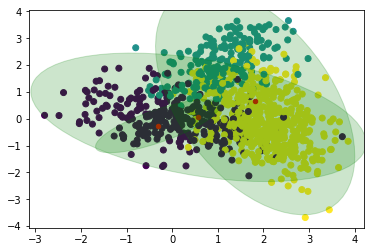

Step 84


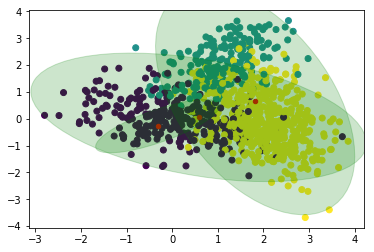

Step 85


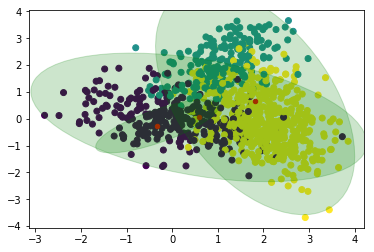

Step 86


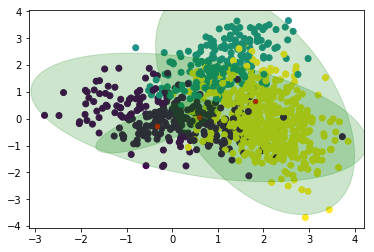

Step 87


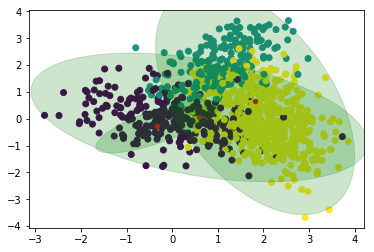

Step 88


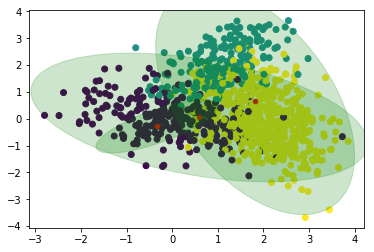

Step 89


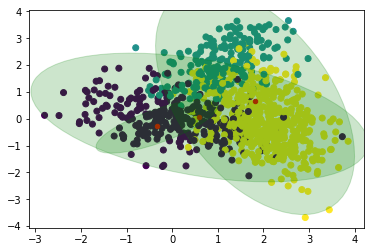

Step 90


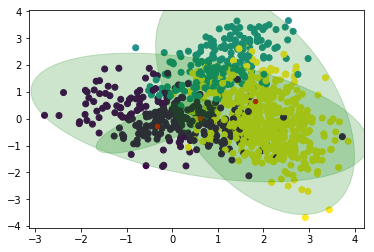

Step 91


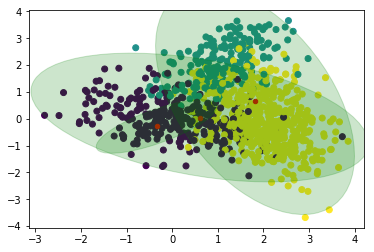

Step 92


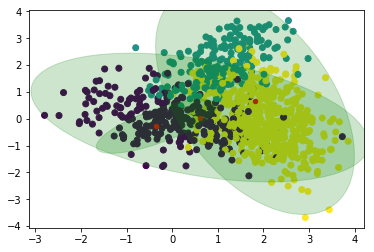

Step 93


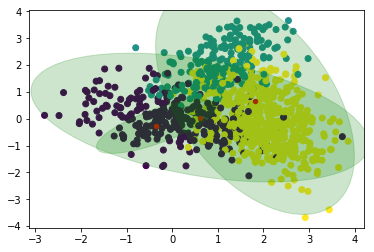

Step 94


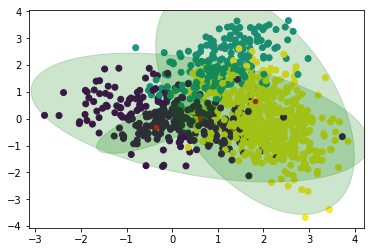

Step 95


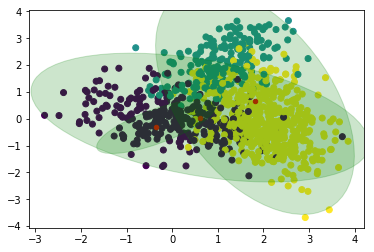

Step 96


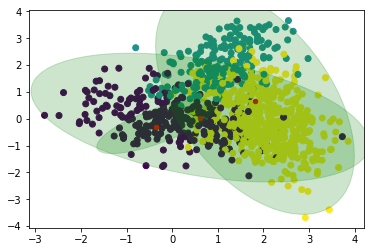

Step 97


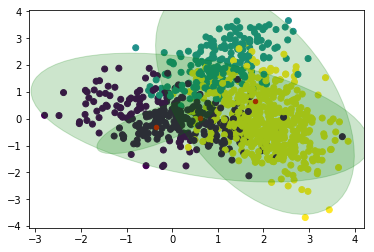

Step 98


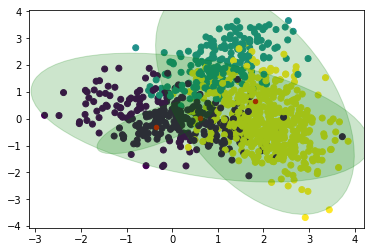

Step 99


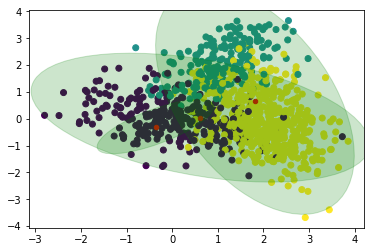

Step 100


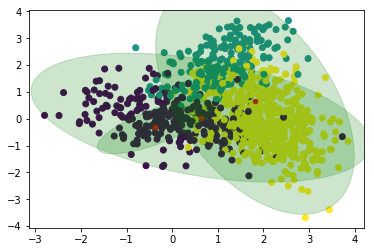

Step 101


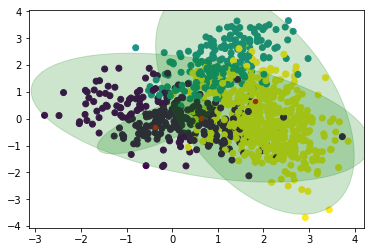

Step 102


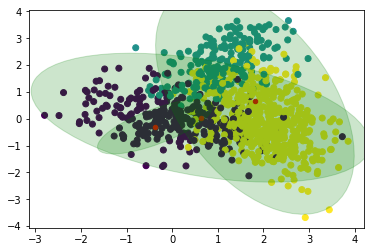

Step 103


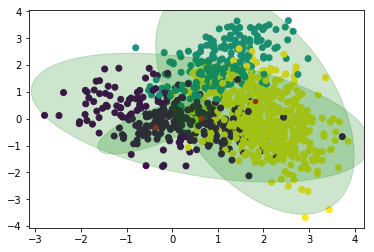

Step 104


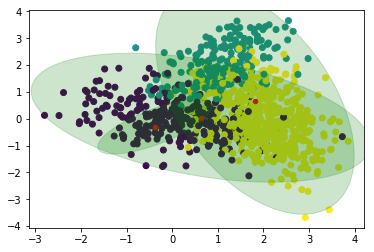

Step 105


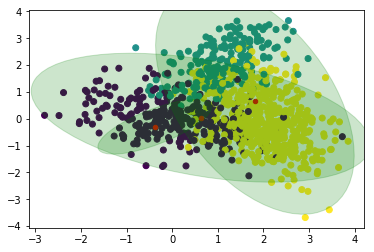

Step 106


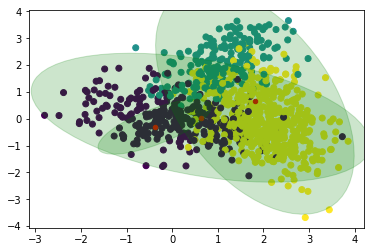

Step 107


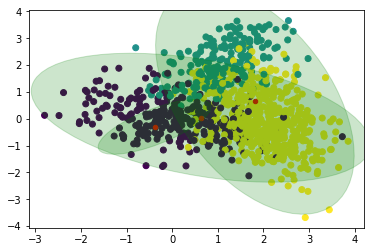

Step 108


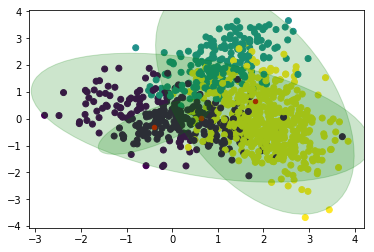

Step 109


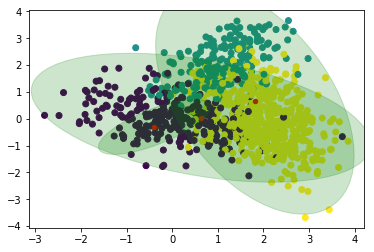

Step 110


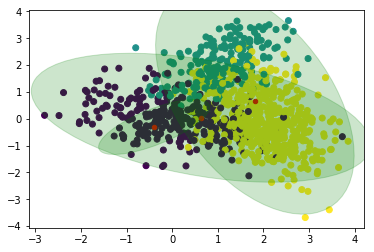

Step 111


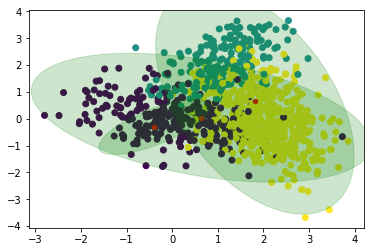

Step 112


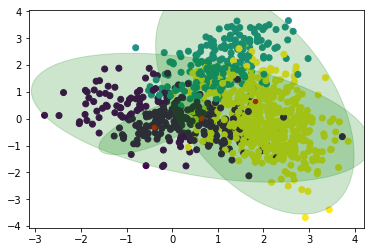

Step 113


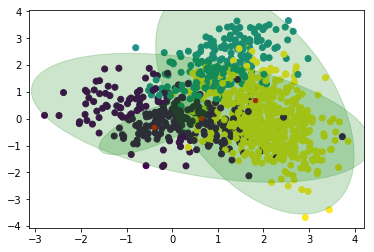

Step 114


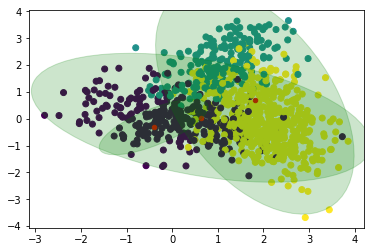

Step 115


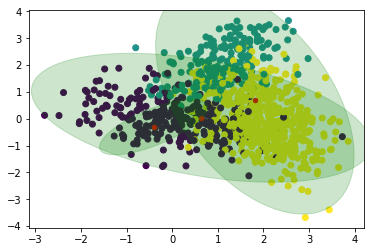

Step 116


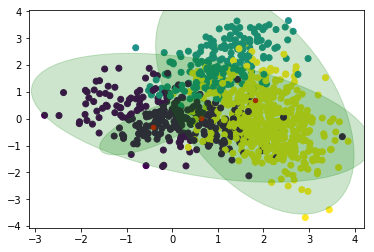

Step 117


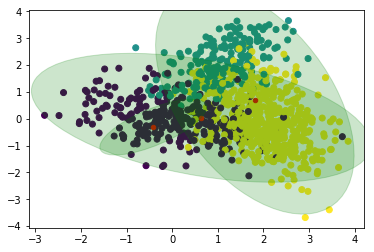

Step 118


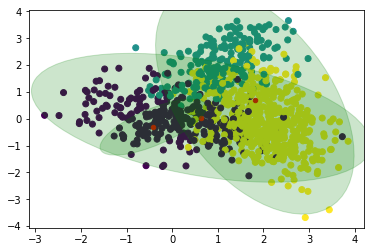

Step 119


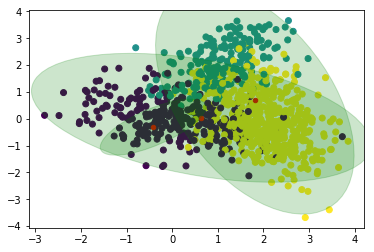

Step 120


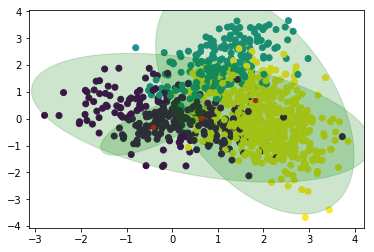

Step 121


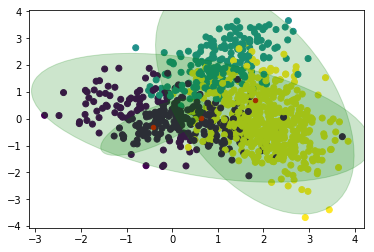

Step 122


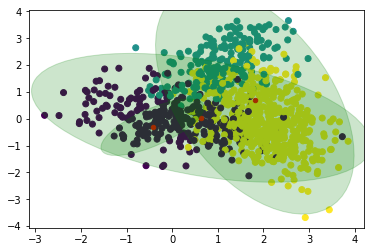

Step 123


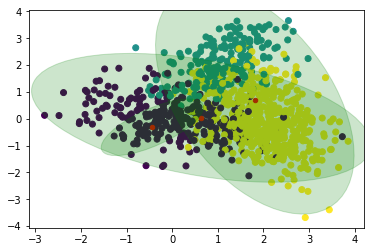

Step 124


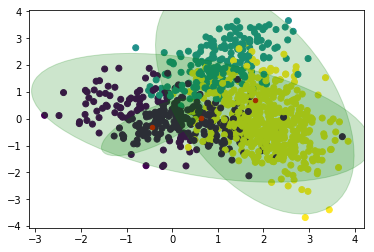

Step 125


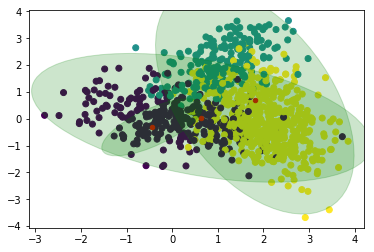

Step 126


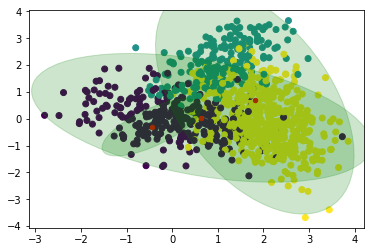

Step 127


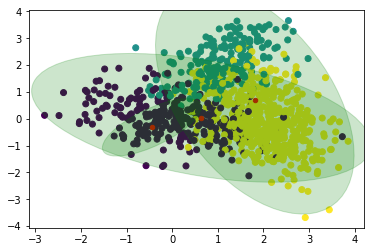

Step 128


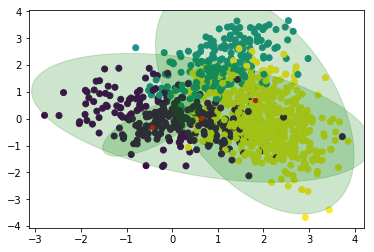

Step 129


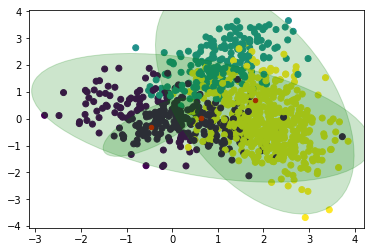

Step 130


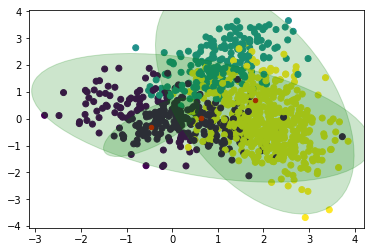

Step 131


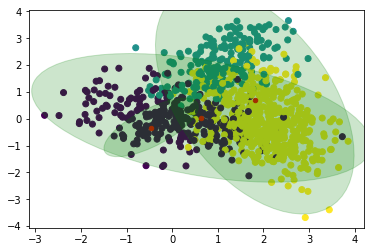

Step 132


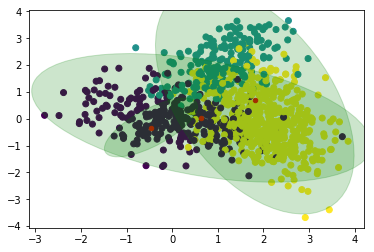

Step 133


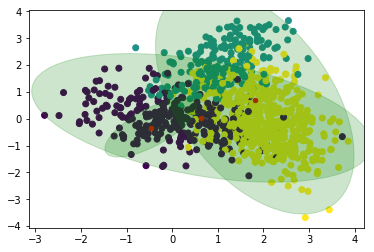

Step 134


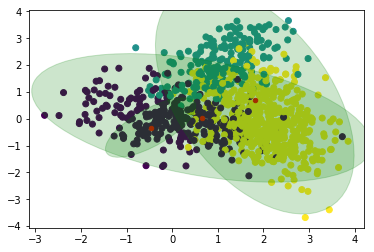

Step 135


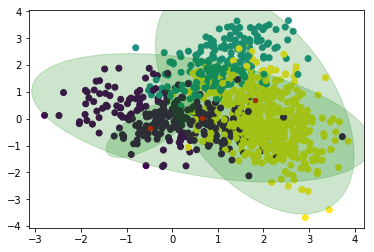

Step 136


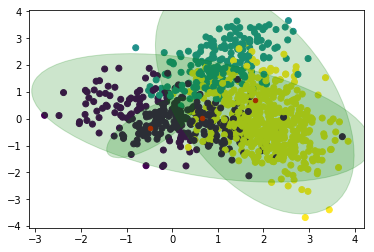

Step 137


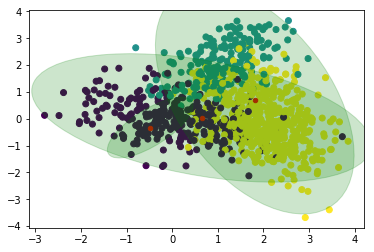

Step 138


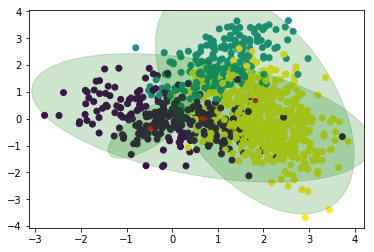

Step 139


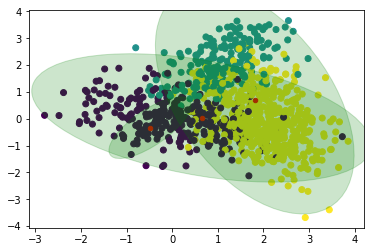

Step 140


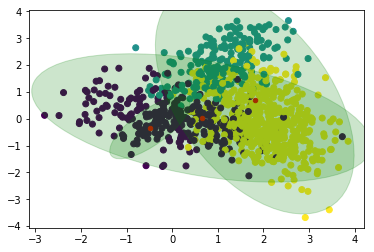

Step 141


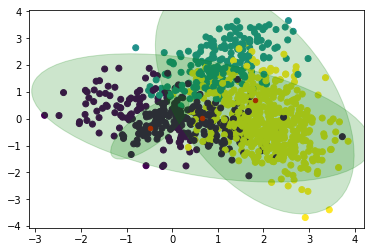

Step 142


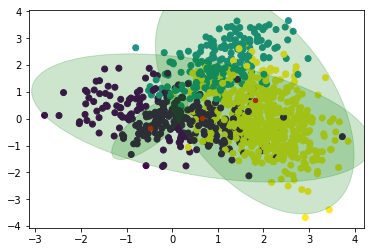

Step 143


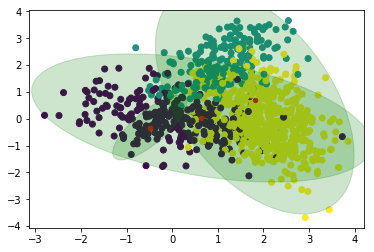

Step 144


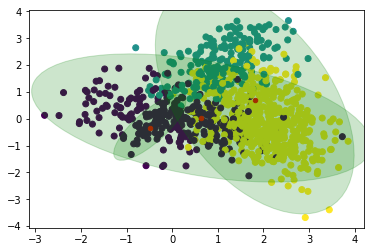

Step 145


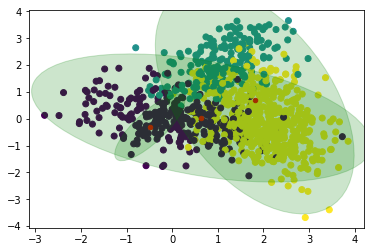

Step 146


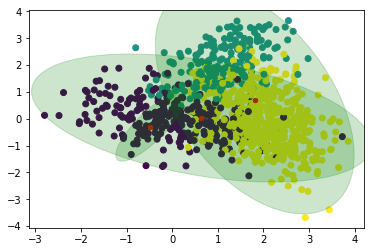

Step 147


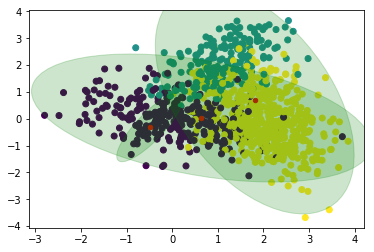

Step 148


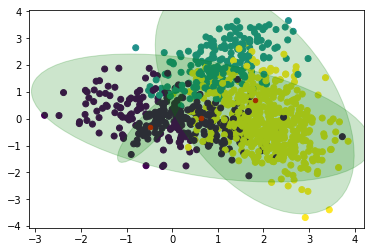

Step 149


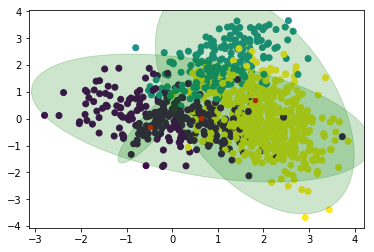

Step 150


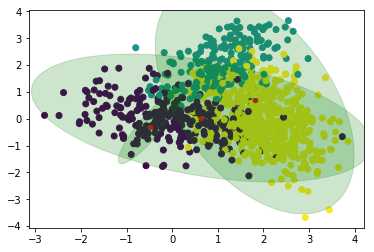

Step 151


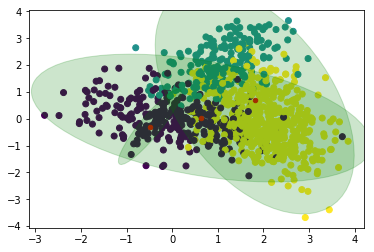

Step 152


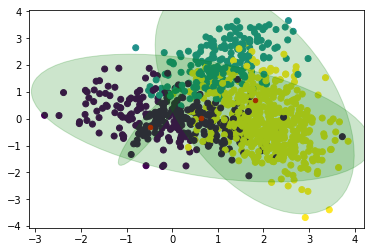

Step 153


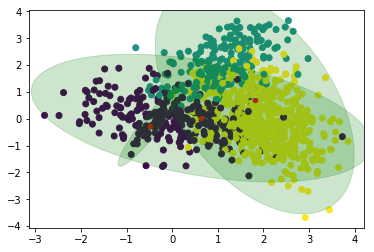

Step 154


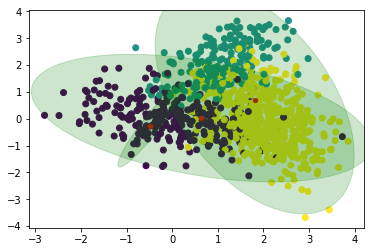

Step 155


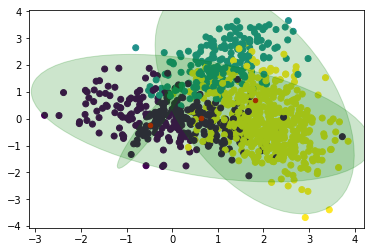

Step 156


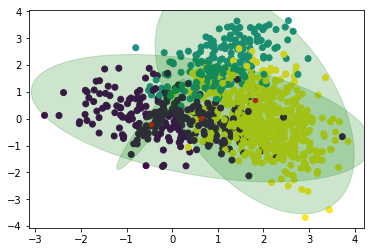

Step 157


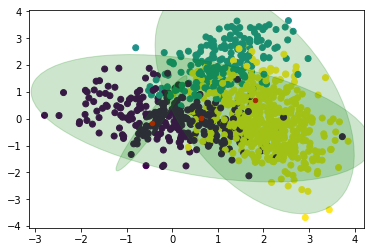

Step 158


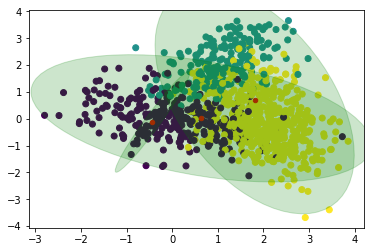

Step 159


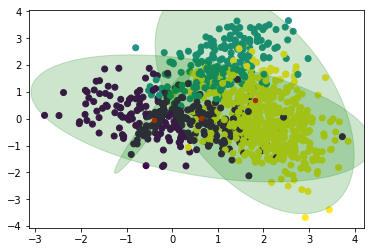

Step 160


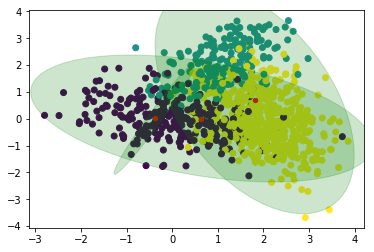

Step 161


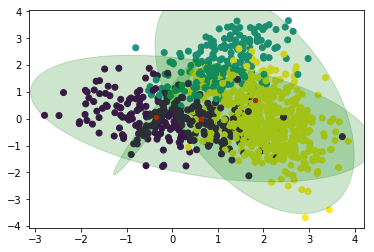

Step 162


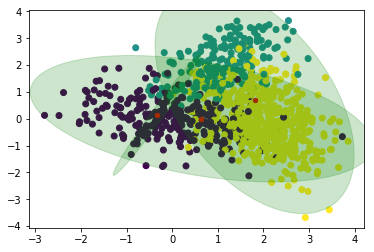

Step 163


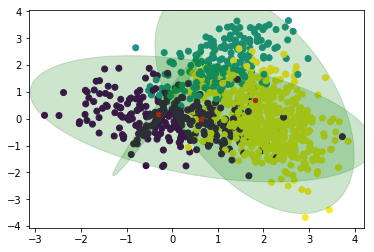

Step 164


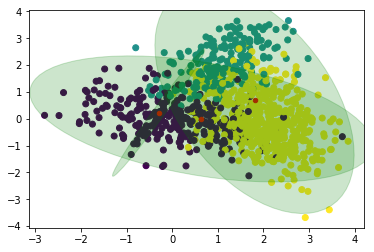

Step 165


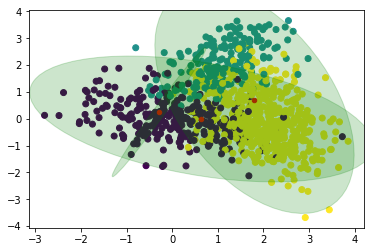

Step 166


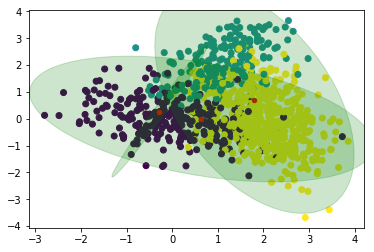

Step 167


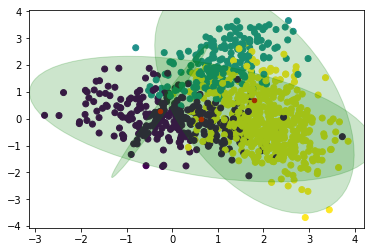

Step 168


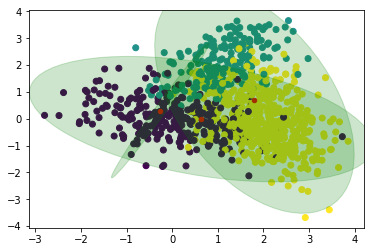

Step 169


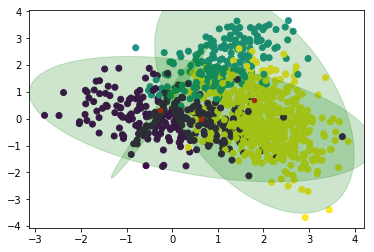

Step 170


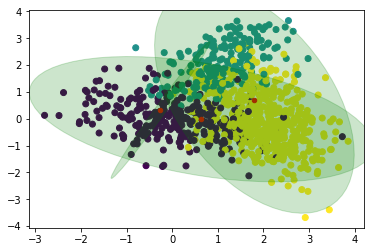

Step 171


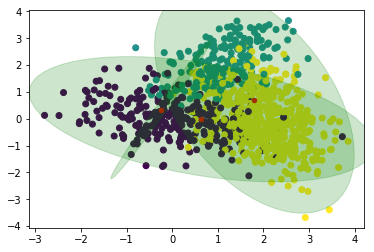

Step 172


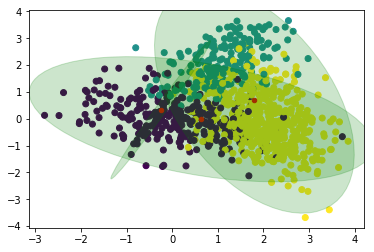

Step 173


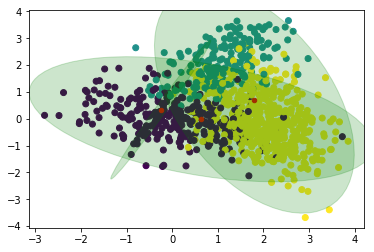

Step 174


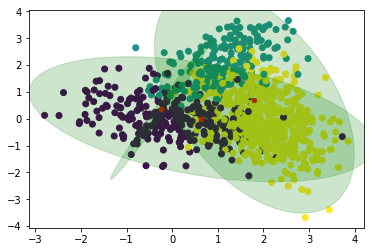

Step 175


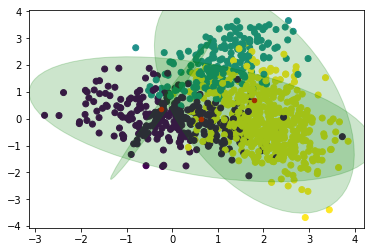

Step 176


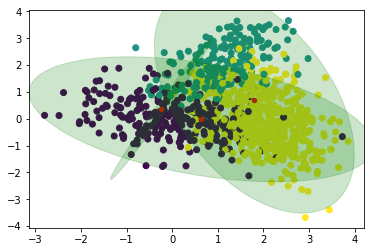

Step 177


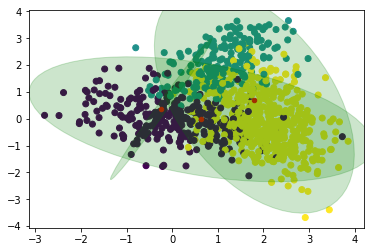

Step 178


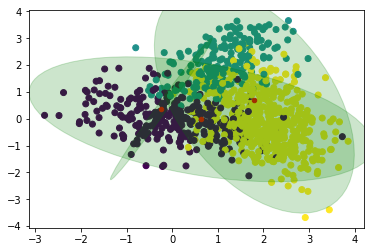

Step 179


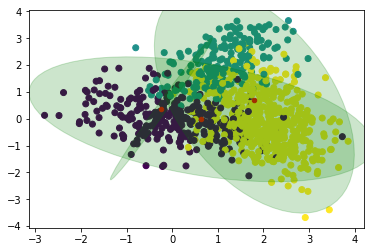

Step 180


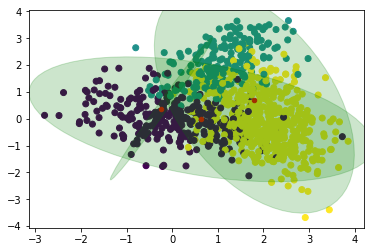

Step 181


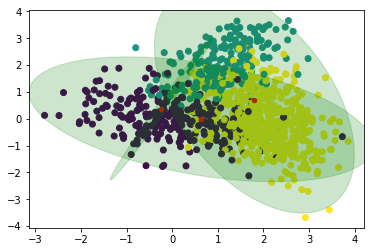

Step 182


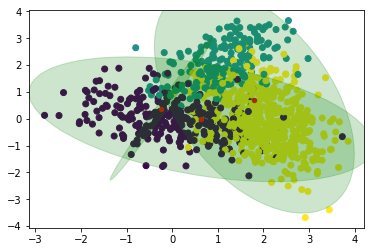

Step 183


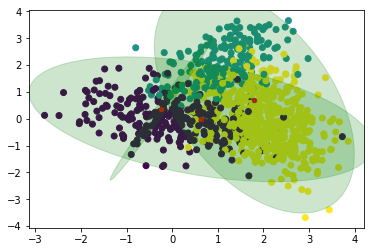

Step 184


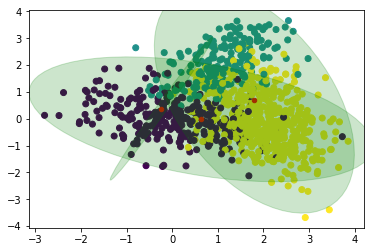

Step 185


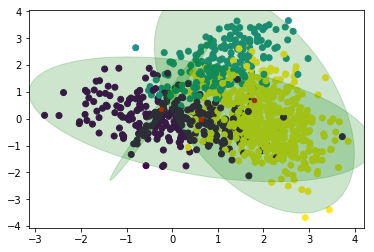

Step 186


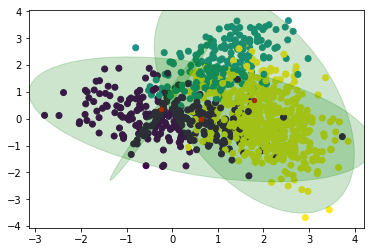

Step 187


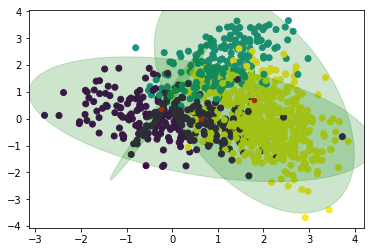

Step 188


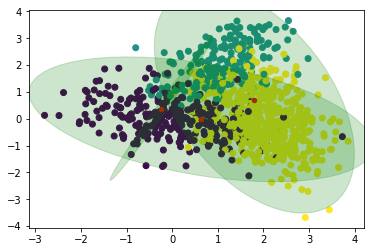

Step 189


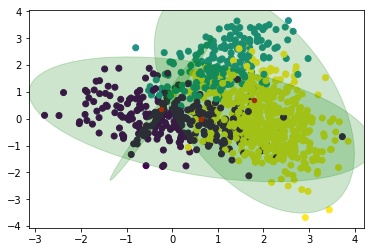

Step 190


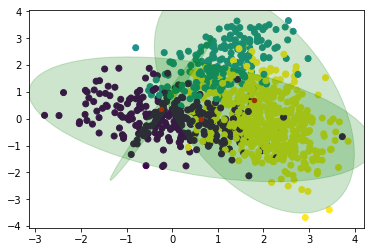

Step 191


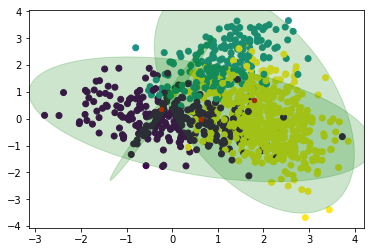

Step 192


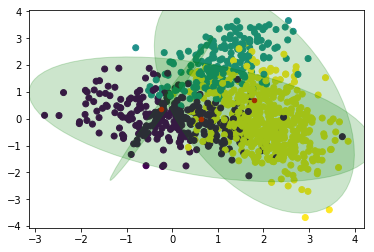

Step 193


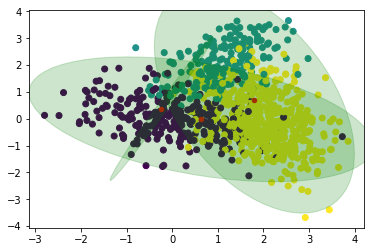

Step 194


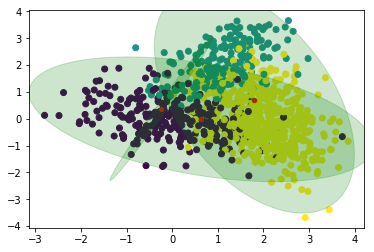

Step 195


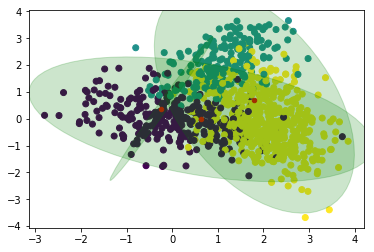

Step 196


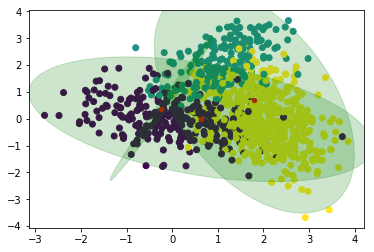

Step 197


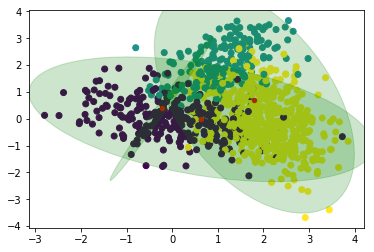

Step 198


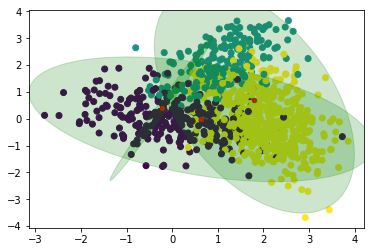

Step 199


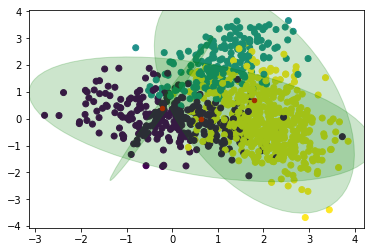

In [31]:
init_v_pi = [0.37510264, 0.03801979, 0.58687757]
init_v_mu = [[0.57893792, 0.38168862],
             [0.78415488, 0.06592463],
             [0.59199756, 0.30968324]]
init_v_Sigma = [[[0.40593776, 0.92796719],
                 [0.91882625, 0.57848892]],
                [[0.84921114, 0.8018145 ],
                [0.30160589, 0.71828568]],
                [[0.43224891, 0.63132965],
                 [0.50335857, 0.25369865]]]
list_pi_final_other_init, list_mu_final_other_init, list_Sigma_final_other_init, log_likelihoods_other_init = \
                                                                        EM_GMM(X_samples,K=3,n_iteration=200,
                                                                              print_out=False,
                                                                              inits=(init_v_pi, 
                                                                                     init_v_mu, 
                                                                                     init_v_Sigma))

We see that the algoritm in this case falls into a local maximum and fails to model correctly the true parameters of the model. We conclude that the EM algorithm is sensitive to different initial values.

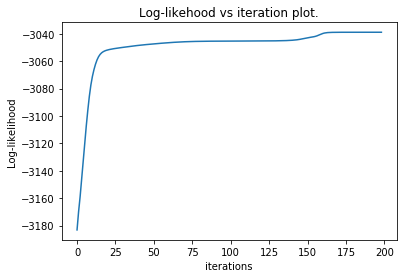

[-3183.1494894071648, -3169.9094891081513, -3158.9039294236027, -3145.9889683210995, -3132.4228300165687, -3119.5285681923942, -3107.302681123214, -3095.8040467419505, -3085.6068241058424, -3077.3672206596457, -3071.0836380367955, -3066.177527734045, -3062.2069642217066, -3059.055982390767, -3056.694855880978, -3055.019346524359, -3053.863735778921, -3053.064655694876, -3052.4963009566427, -3052.0737158318107, -3051.743098521827, -3051.471207058107, -3051.2375514482364, -3051.029380166043, -3050.838628221049, -3050.660087227435, -3050.4903040759677, -3050.3269104614674, -3050.16821163708, -3050.012938494696, -3049.860110763556, -3049.7089821782665, -3049.5590468569108, -3049.410083330852, -3049.2622030458533, -3049.1158618905865, -3048.971798195503, -3048.830887303123, -3048.69394520329, -3048.5615473375497, -3048.433926937453, -3048.310978057676, -3048.192339781986, -3048.0775121605607, -3047.965960089557, -3047.8571838341404, -3047.7507555388, -3047.6463313289155, -3047.5436498709596

In [32]:
log_likelihoods_other_init = log_likelihoods_other_init[1:]
plt.plot(log_likelihoods_other_init)
plt.title("Log-likehood vs iteration plot.")
plt.xlabel('iterations')
plt.ylabel('Log-likelihood') 
plt.show()
print(log_likelihoods_other_init)

The likelihood attains a value of -3038, while it was -3002 in the last case.